<a href="https://colab.research.google.com/github/fatemeh-ict/Deep-learnin/blob/main/semantic_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install kaggle

In [2]:
!pip install -q git+https://github.com/tensorflow/examples.git

  Preparing metadata (setup.py) ... done


In [3]:
!mkdir ~/.kaggle

In [4]:
!touch ~/.kaggle/kaggle.json

In [5]:
api_token={"username":"fatiiii8077","key":"453a28a8592937f6f110a7ecb5a787f2"}
import json
with open('/root/.kaggle/kaggle.json','w') as file:
  json.dump(api_token,file)
!chmod 600 ~/.kaggle/kaggle.json

In [6]:
!kaggle datasets download -d rajkumarl/people-clothing-segmentation

 99% 609M/616M [00:09<00:00, 49.7MB/s]
100% 616M/616M [00:09<00:00, 66.2MB/s]


In [7]:
!unzip people-clothing-segmentation.zip -d Clothes_segmentation

Archive:  people-clothing-segmentation.zip
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0001.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0002.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0003.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0004.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0005.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0006.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0007.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0008.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0009.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0010.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0011.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0012.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_0013.jpeg  
  inflating: Clothes_segmentation/jpeg_images/IMAGES/img_001

In [8]:

import os
import glob
import cv2
import numpy as np
from matplotlib import pyplot as plt
import math
from pathlib import Path
import re
from skimage import measure
from sklearn.metrics import mean_absolute_error, mean_squared_error, accuracy_score
import matplotlib as mpl
import tqdm
import tensorflow as tf
from tensorflow_examples.models.pix2pix import pix2pix
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import normalize
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.metrics import MeanIoU
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda

In [9]:
images_path = "/content/Clothes_segmentation/png_images/IMAGES"
masks_path = "/content/Clothes_segmentation/png_masks/MASKS"

In [10]:
import pandas as pd
df=pd.read_csv('/content/Clothes_segmentation/labels.csv')
df.head()

,Unnamed: 0,label_list
0,0,NaN
1,1,accessories
2,2,bag
3,3,belt
4,4,blazer


In [11]:
df.shape

(59, 2)

In [12]:
OUTPUT_CHANNELS = 9
classes = {'bg':0, 'accessories': 1,  'bag': 2,  'clothes': 3, 'shoes': 4, 'glasses': 5,  'hair': 6,  'hat': 7,  'skin': 8}
convs = {0: 0, 1: 1, 2: 2, 3: 3, 4: 3, 5: 3, 6: 3, 7: 4, 8: 3, 9: 1, 10: 3, 11: 3, 12: 4, 13: 3, 14: 3, 15: 1, 16: 4, 17: 5, 18: 3, 19: 6, 20: 7, 21: 4, 22: 3, 23: 3, 24: 3, 25: 3, 26: 3, 27: 3, 28: 4, 29: 1, 30: 3, 31: 3, 32: 4, 33: 3, 34: 1, 35: 3, 36: 4, 37: 3, 38: 3, 39: 4, 40: 3, 41: 8, 42: 3, 43: 4, 44: 3, 45: 3, 46: 3, 47: 5, 48: 3, 49: 3, 50: 3, 51: 3, 52: 3, 53: 3, 54: 3, 55: 3, 56: 3, 57: 1, 58: 4}

In [13]:
def standardize(x):
    x = np.array(x, dtype='float64')
    x -= np.min(x)
    x /= np.percentile(x, 98)
    x[x > 1] = 1
    return x

def preprocessing(img):
    image = np.array(img)
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    image = np.zeros_like(image)
    image[:,:,0] = gray
    image[:,:,1] = gray
    image[:,:,2] = gray
    image = standardize(image)
    return image

In [14]:
#Capture training image info as a list
images_paths = []
masks_paths = []

for imgname in os.listdir(images_path):
  images_paths.append(os.path.join(images_path,imgname))

for imgname in os.listdir(masks_path):
  masks_paths.append(os.path.join(masks_path,imgname))

In [15]:
print(images_paths[:5])

['/content/Clothes_segmentation/png_images/IMAGES/img_0935.png', '/content/Clothes_segmentation/png_images/IMAGES/img_0027.png', '/content/Clothes_segmentation/png_images/IMAGES/img_0808.png', '/content/Clothes_segmentation/png_images/IMAGES/img_0609.png', '/content/Clothes_segmentation/png_images/IMAGES/img_0510.png']


In [16]:
print(masks_paths[:5])

['/content/Clothes_segmentation/png_masks/MASKS/seg_0034.png', '/content/Clothes_segmentation/png_masks/MASKS/seg_0286.png', '/content/Clothes_segmentation/png_masks/MASKS/seg_0826.png', '/content/Clothes_segmentation/png_masks/MASKS/seg_0122.png', '/content/Clothes_segmentation/png_masks/MASKS/seg_0273.png']


In [17]:
images_paths.sort()
masks_paths.sort()

In [18]:
#Resizing images
size_x = 256
size_y = 256
n_classes=9 #Number of classes for segmentation

#Capture training image info as a list
train_images = []
train_masks = []

for imgpath in tqdm.tqdm(images_paths):
  img = cv2.imread(imgpath)
  img = cv2.resize(img, (size_y, size_x))
  img = preprocessing(img)
  train_images.append(img)


for maskpath in tqdm.tqdm(masks_paths):
  mask0 = cv2.imread(maskpath, 0)
  mask1 = cv2.resize(mask0, (size_y, size_x), interpolation = cv2.INTER_NEAREST)  #Otherwise ground truth changes due to interpolation
  for oldnum in range(0,59):
      new_num = convs[oldnum]
      mask1[mask1==oldnum]=new_num
  train_masks.append(mask1)

100%|██████████| 1000/1000 [00:02<00:00, 343.17it/s]


In [19]:
train_images = np.array(train_images)
train_masks = np.array(train_masks)

In [20]:
x_train, x_val, y_train, y_val = train_test_split(train_images, train_masks, test_size = 0.10, shuffle=True, random_state = 1)
print("Class values: ", np.unique(y_train))

Class values:  [0 1 2 3 4 5 6 7 8]


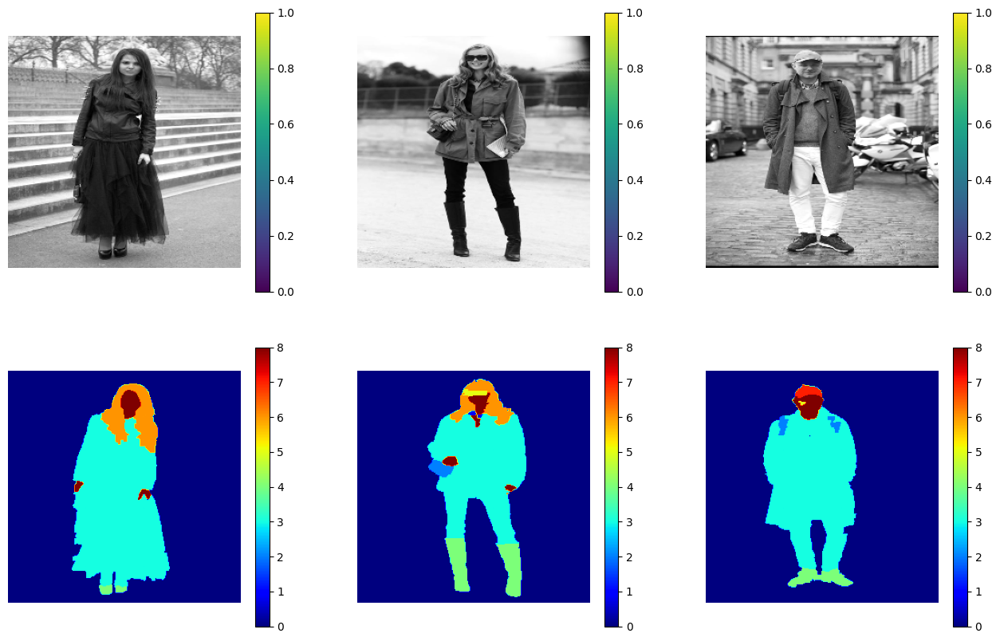

In [21]:
NORM = mpl.colors.Normalize(vmin=0, vmax=8)

plt.figure(figsize=(16,10))
for i in range(1,4):
    plt.subplot(2,3,i)
    img = train_images[i]
    plt.imshow(img)
    plt.colorbar()
    plt.axis('off')

for i in range(4,7):
    plt.subplot(2,3,i)
    img = np.squeeze(train_masks[i-3])
    plt.imshow(img, cmap='jet', norm=NORM)
    plt.colorbar()
    plt.axis('off')
plt.show()

9406464/9406464 [==============================] - 0s 0us/step


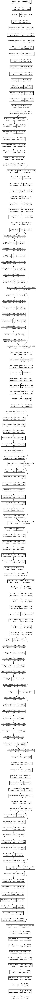

In [22]:
from tensorflow import keras

base = MobileNetV2(input_shape=[128,128,3], include_top=False)
keras.utils.plot_model(base,show_shapes=True)

Define mdel

In [23]:
def unet_model(output_channels):
    img_height = x_train.shape[1]
    img_width  = x_train.shape[2]
    img_channels = x_train.shape[3]

    base_model = MobileNetV2(input_shape=[img_height, img_width, img_channels], include_top=False)

    # Use the activations of these layers
    layer_names = [
        'block_1_expand_relu',   # 64x64
        'block_3_expand_relu',   # 32x32
        'block_6_expand_relu',   # 16x16
        'block_13_expand_relu',  # 8x8
        'block_16_project',      # 4x4
    ]

    base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

    # Create the feature extraction model
    down_stack = Model(inputs=base_model.input, outputs=base_model_outputs)

    down_stack.trainable = False

    up_stack = [
        pix2pix.upsample(512, 3),  # 4x4 -> 8x8
        pix2pix.upsample(256, 3),  # 8x8 -> 16x16
        pix2pix.upsample(128, 3),  # 16x16 -> 32x32
        pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    ]

    inputs = Input(shape=[img_height, img_width, img_channels])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = Concatenate()
        x = concat([x, skip])

    # This is the last layer of the model
    last = Conv2DTranspose(OUTPUT_CHANNELS, 3, strides=2, padding='same')  #64x64 -> 128x128

    x = last(x)

    return Model(inputs=inputs, outputs=x)

In [24]:
model = unet_model(OUTPUT_CHANNELS)
model.compile(optimizer='adam',
              loss=SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])   #metrics=[tf.keras.metrics.MeanIoU(num_classes=9)])

9406464/9406464 [==============================] - 0s 0us/step


In [27]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask[0]


def show_predictions(epoch, dataset=None, num=50):
  if dataset:

    for image, mask in dataset.take(num):
        pred_mask = model.predict(image)
        plt.figure(figsize=(15, 10))
        plt.subplot(231)
        plt.title('Testing Image')
        plt.imshow(image[0], cmap='gray')
        plt.subplot(232)
        plt.title('Ground Truth')
        plt.imshow(mask[0], cmap='jet')
        plt.subplot(233)
        plt.title('Prediction on test image')
        plt.imshow(create_mask(pred_mask), cmap='jet')

        plt.savefig(f"results/mask_{str(ii)}.png")

        plt.show()
  else:
      fig = plt.figure(figsize=(12, 12))
      fig.suptitle(f"\n Epoch: {str(epoch)}\n", fontsize=16)

      plt.subplot(331)
      plt.title('Testing Image')
      plt.imshow(train_images[num], cmap='gray')
      plt.subplot(332)
      plt.title('Ground Truth')
      plt.imshow(train_masks[num], cmap='jet')
      plt.subplot(333)
      plt.title('Prediction on test image')
      plt.imshow(create_mask(model.predict(train_images[num][tf.newaxis, ...]))[:,:,0], cmap='jet')

      plt.subplot(334)
      plt.imshow(train_images[num+16], cmap='gray')
      plt.subplot(335)
      plt.imshow(train_masks[num+16], cmap='jet')
      plt.subplot(336)
      plt.imshow(create_mask(model.predict(train_images[num+16][tf.newaxis, ...]))[:,:,0], cmap='jet')
      plt.subplot(337)
      plt.imshow(train_images[num+14], cmap='gray')
      plt.subplot(338)
      plt.imshow(train_masks[num+14], cmap='jet')
      plt.subplot(339)
      plt.imshow(create_mask(model.predict(train_images[num+14][tf.newaxis, ...]))[:,:,0], cmap='jet')

      #plt.savefig(f"results/mask_{str(num+100)}_{str(epoch)}.png")

      plt.show()

Epoch 1/50
1/1 [==============================] - 0s 30ms/step


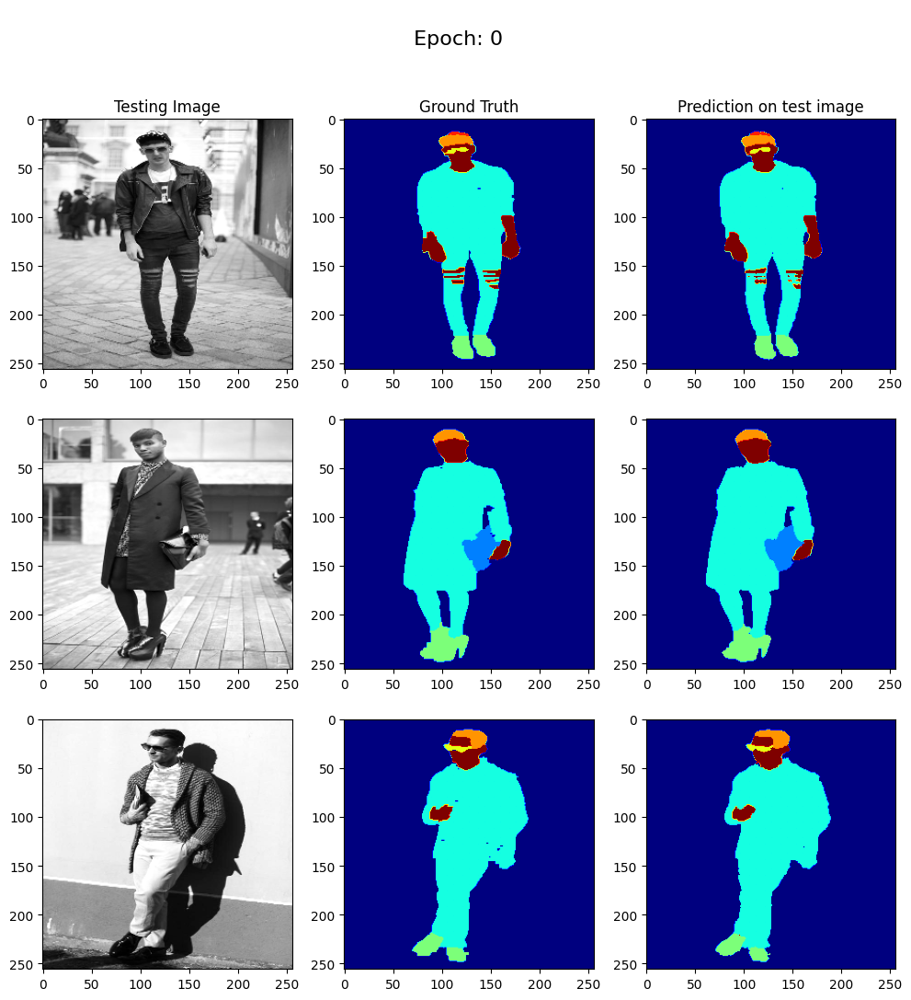

1
57/57 [==============================] - 14s 253ms/step - loss: 0.0140 - accuracy: 0.9946 - val_loss: 0.2266 - val_accuracy: 0.9557
Epoch 2/50
1/1 [==============================] - 0s 41ms/step


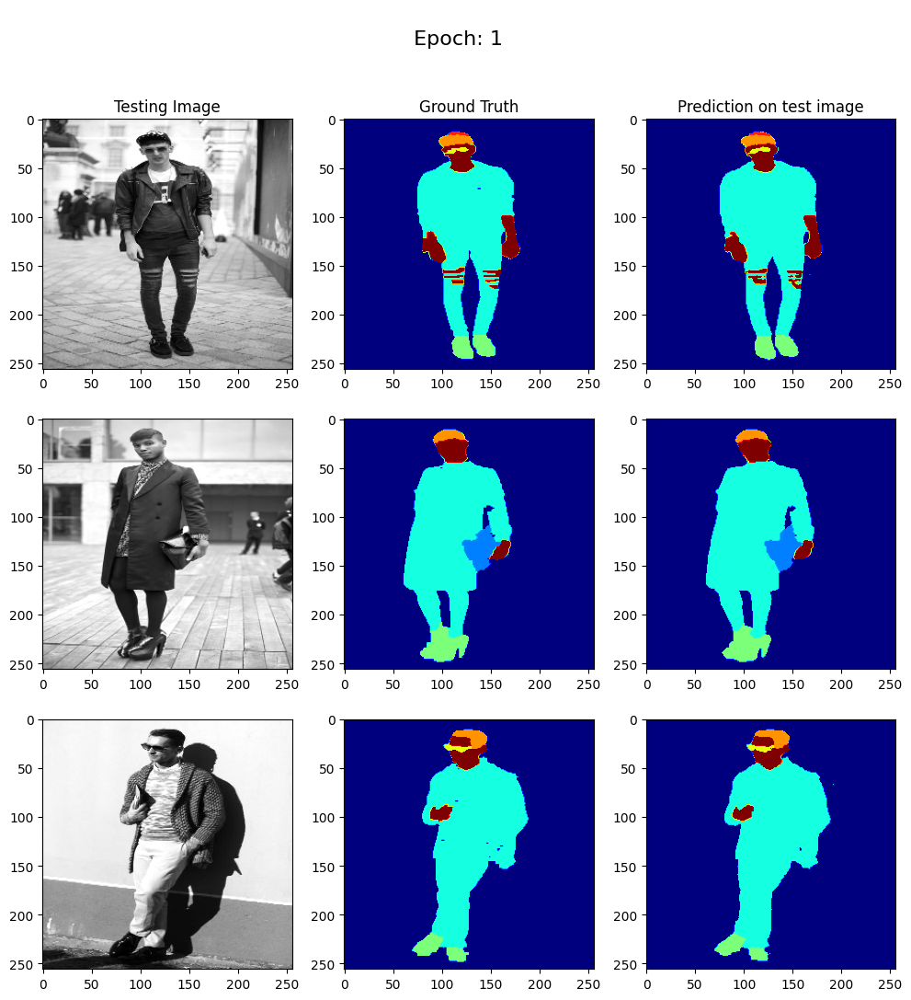

2
57/57 [==============================] - 10s 184ms/step - loss: 0.0134 - accuracy: 0.9948 - val_loss: 0.2353 - val_accuracy: 0.9563
Epoch 3/50
1/1 [==============================] - 0s 26ms/step


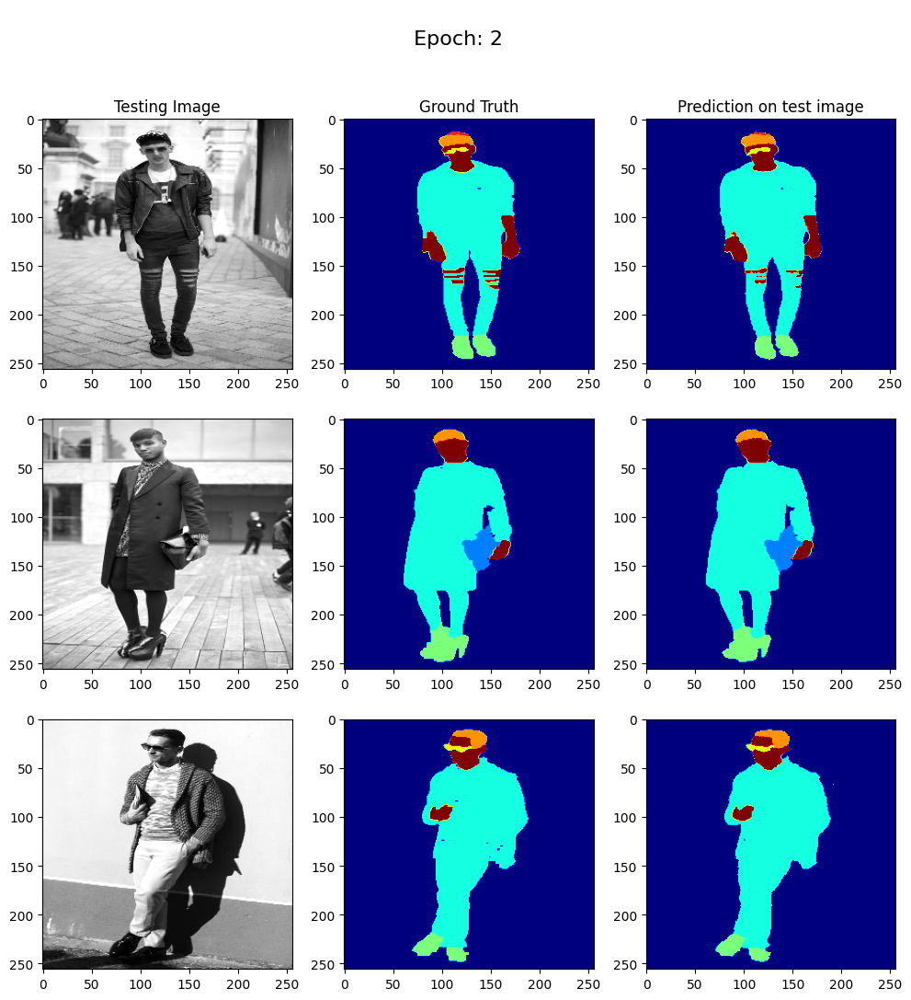

3
57/57 [==============================] - 10s 181ms/step - loss: 0.0133 - accuracy: 0.9948 - val_loss: 0.2351 - val_accuracy: 0.9560
Epoch 4/50
1/1 [==============================] - 0s 29ms/step


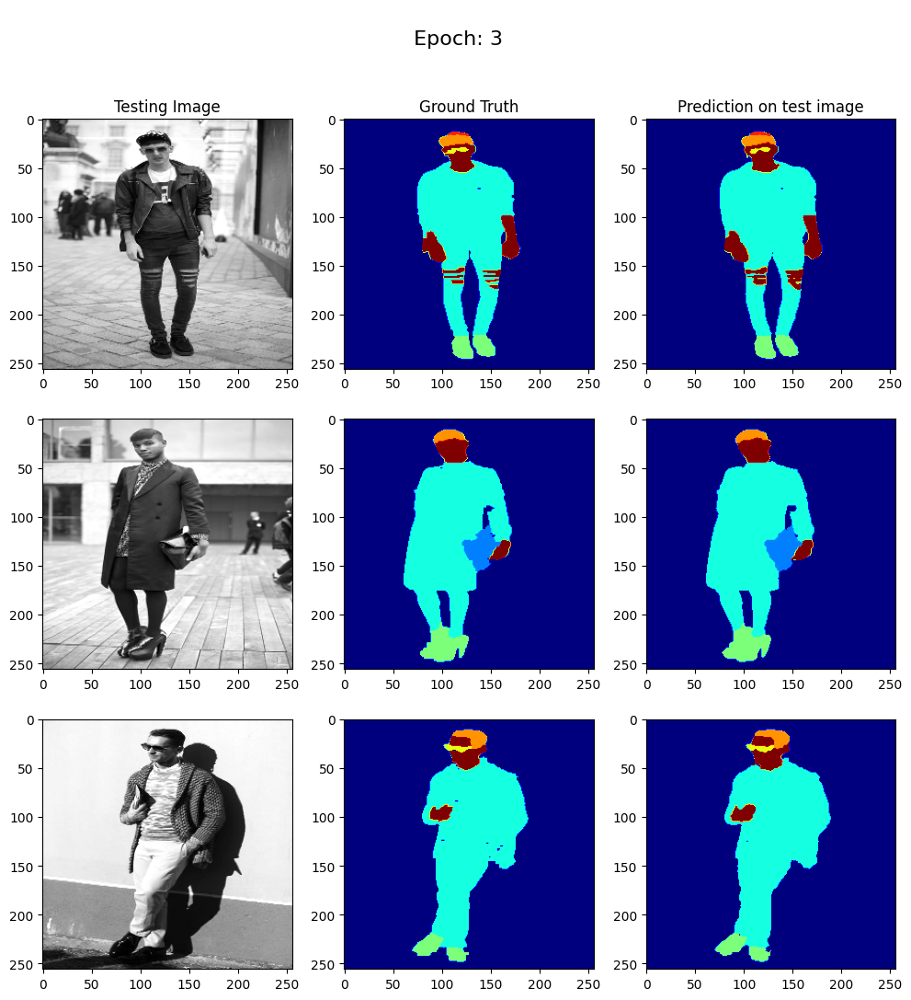

4
57/57 [==============================] - 10s 169ms/step - loss: 0.0128 - accuracy: 0.9950 - val_loss: 0.2299 - val_accuracy: 0.9555
Epoch 5/50
1/1 [==============================] - 0s 29ms/step


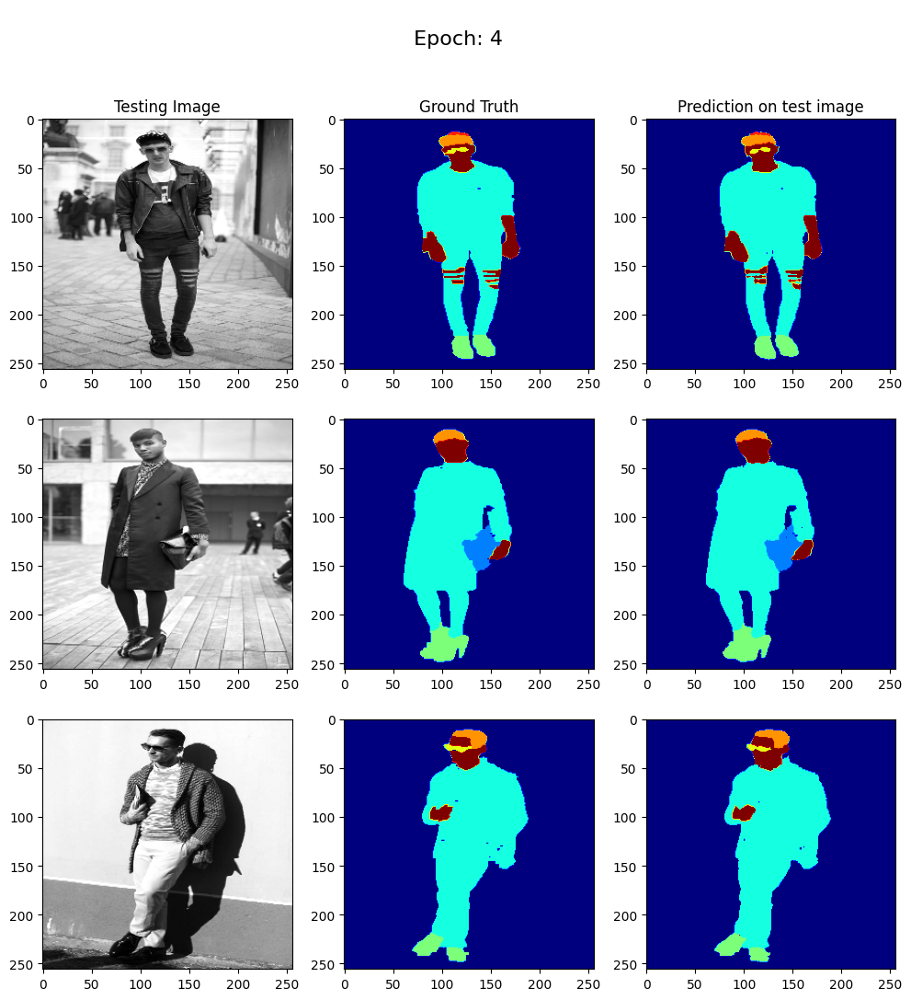

5
57/57 [==============================] - 10s 170ms/step - loss: 0.0126 - accuracy: 0.9951 - val_loss: 0.2336 - val_accuracy: 0.9550
Epoch 6/50
1/1 [==============================] - 0s 27ms/step


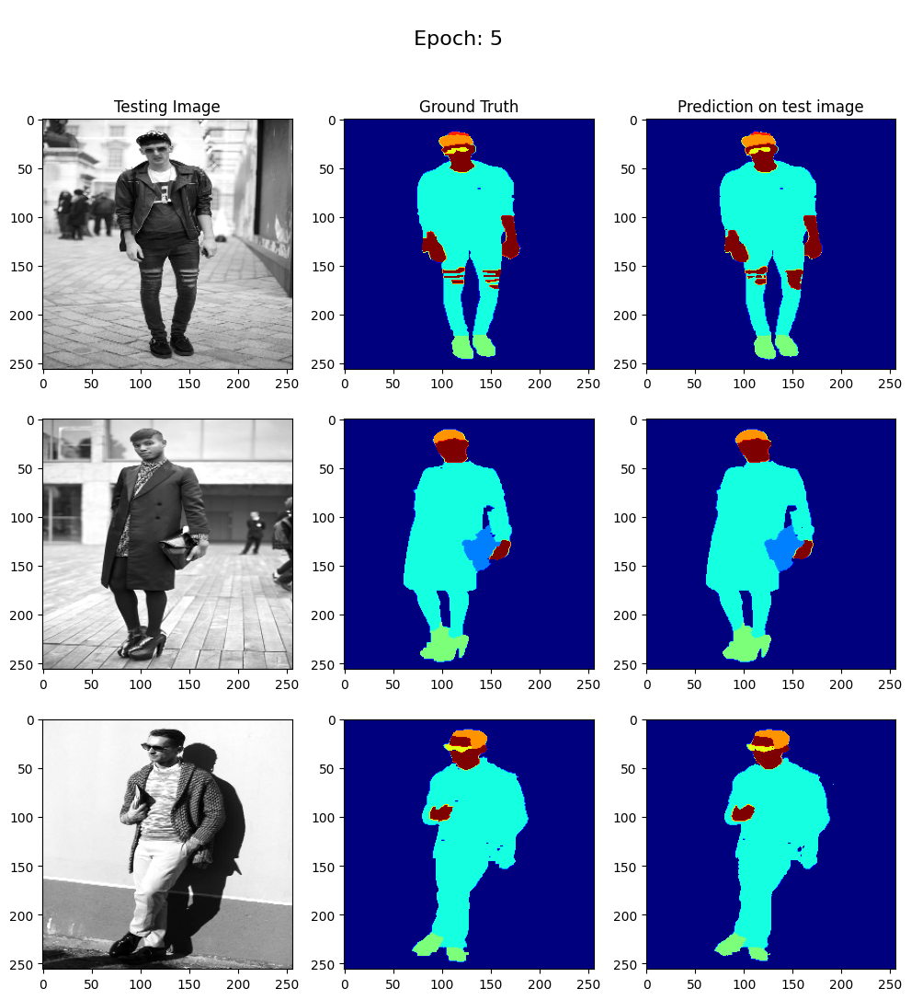

6
57/57 [==============================] - 10s 181ms/step - loss: 0.0127 - accuracy: 0.9950 - val_loss: 0.2336 - val_accuracy: 0.9563
Epoch 7/50
1/1 [==============================] - 0s 26ms/step


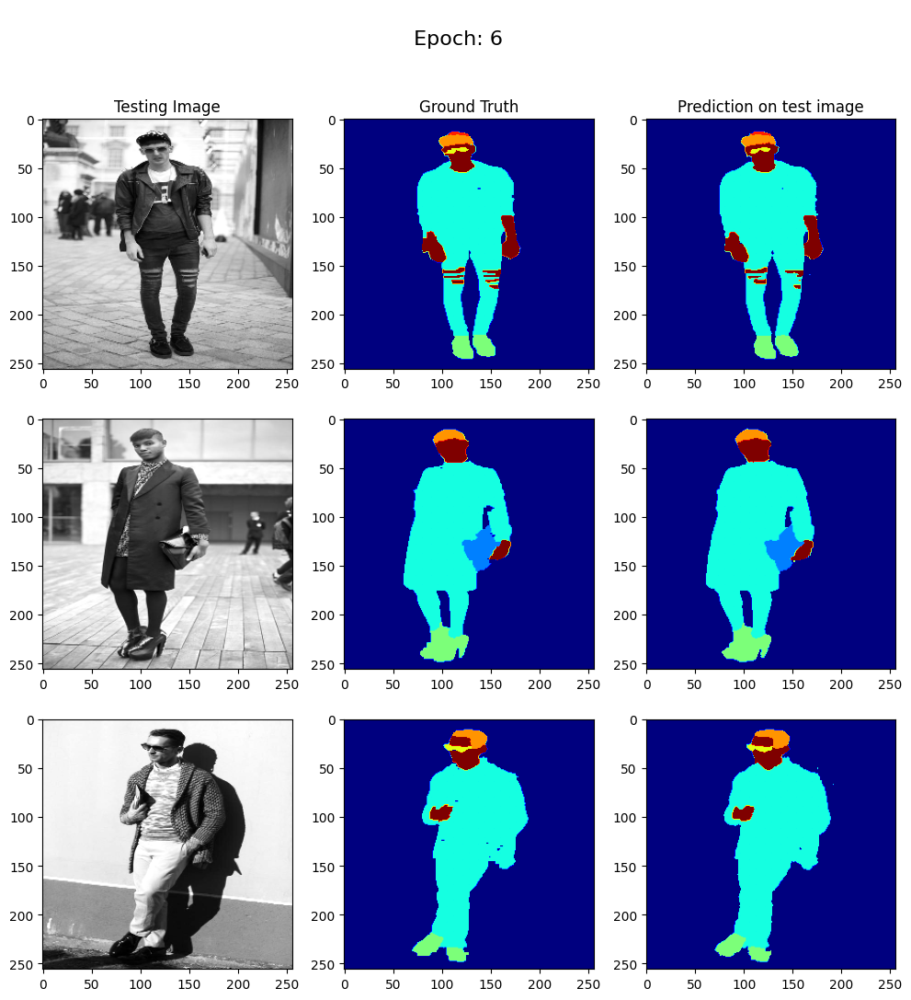

7
57/57 [==============================] - 10s 170ms/step - loss: 0.0122 - accuracy: 0.9952 - val_loss: 0.2398 - val_accuracy: 0.9563
Epoch 8/50
1/1 [==============================] - 0s 29ms/step


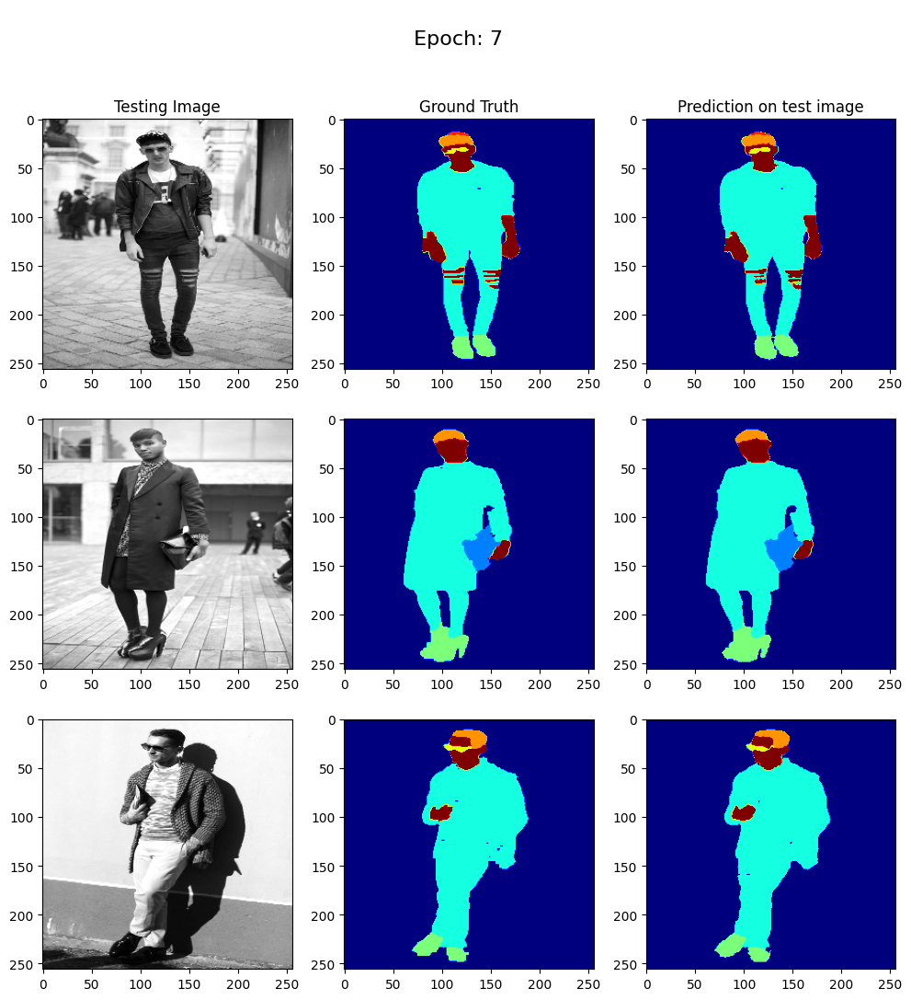

8
57/57 [==============================] - 10s 172ms/step - loss: 0.0128 - accuracy: 0.9950 - val_loss: 0.2374 - val_accuracy: 0.9563
Epoch 9/50
1/1 [==============================] - 0s 41ms/step


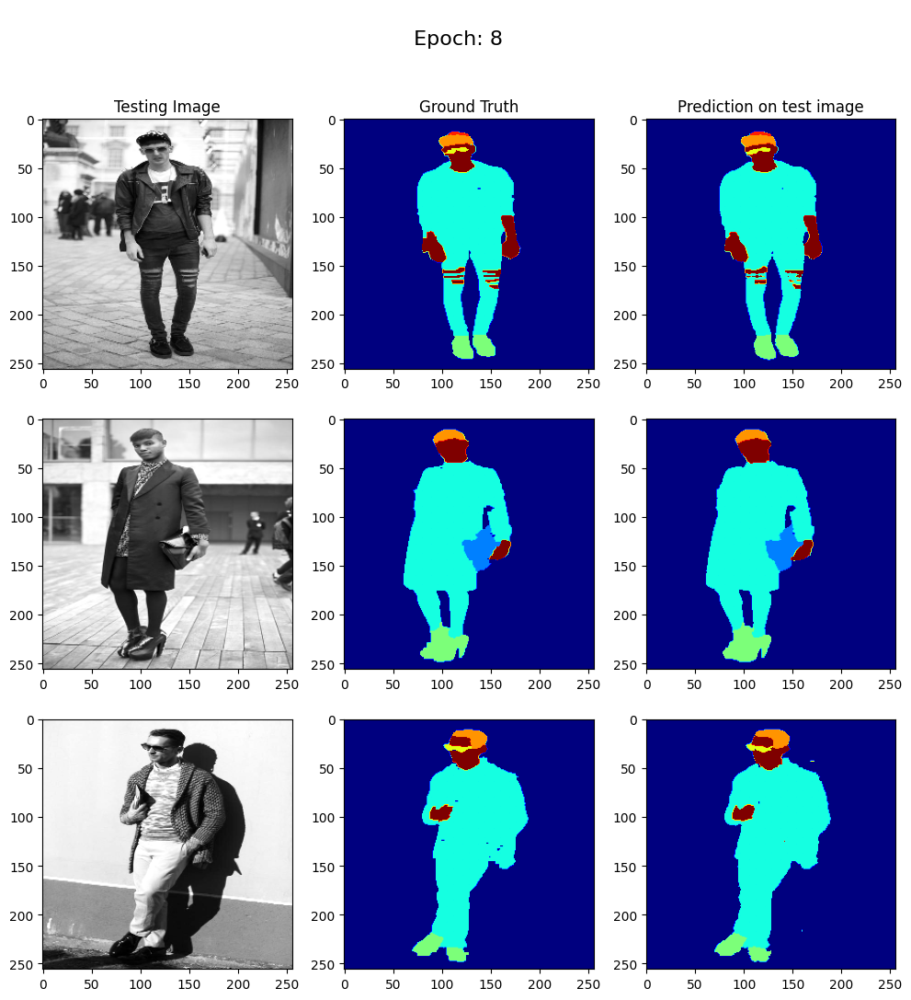

9
57/57 [==============================] - 11s 201ms/step - loss: 0.0122 - accuracy: 0.9952 - val_loss: 0.2413 - val_accuracy: 0.9560
Epoch 10/50
1/1 [==============================] - 0s 26ms/step


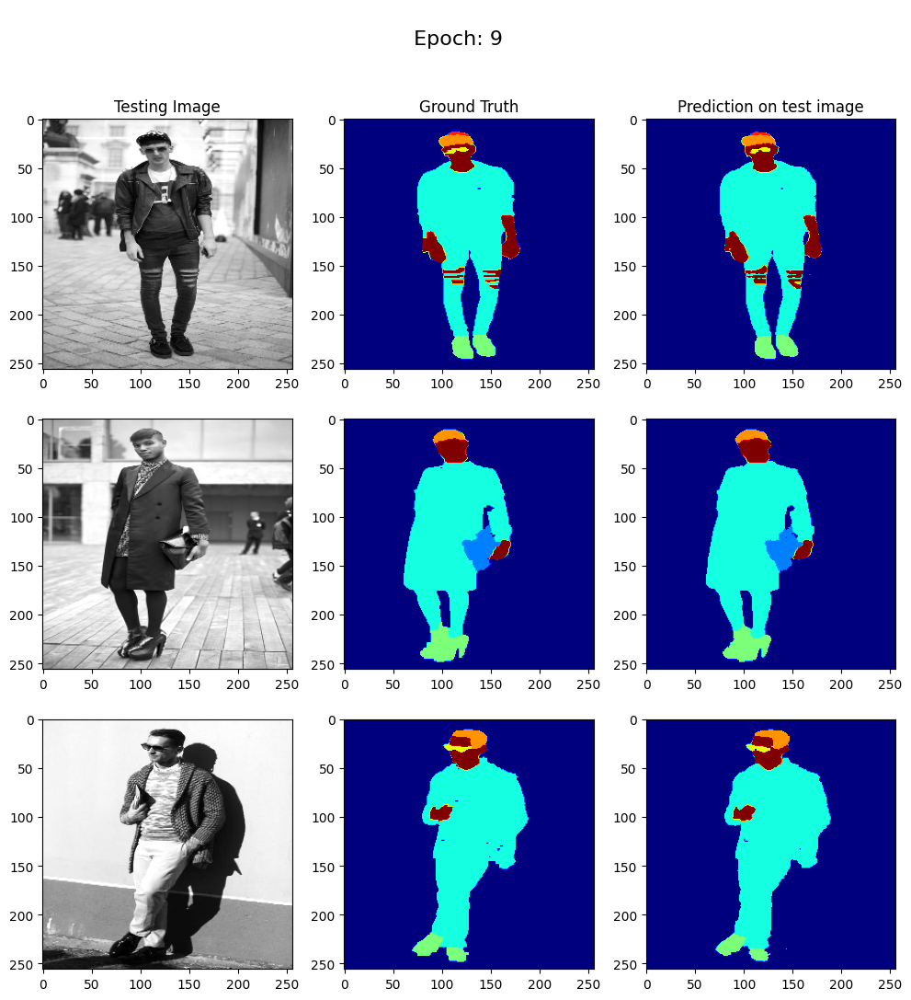

10
57/57 [==============================] - 10s 172ms/step - loss: 0.0119 - accuracy: 0.9953 - val_loss: 0.2495 - val_accuracy: 0.9558
Epoch 11/50
1/1 [==============================] - 0s 26ms/step


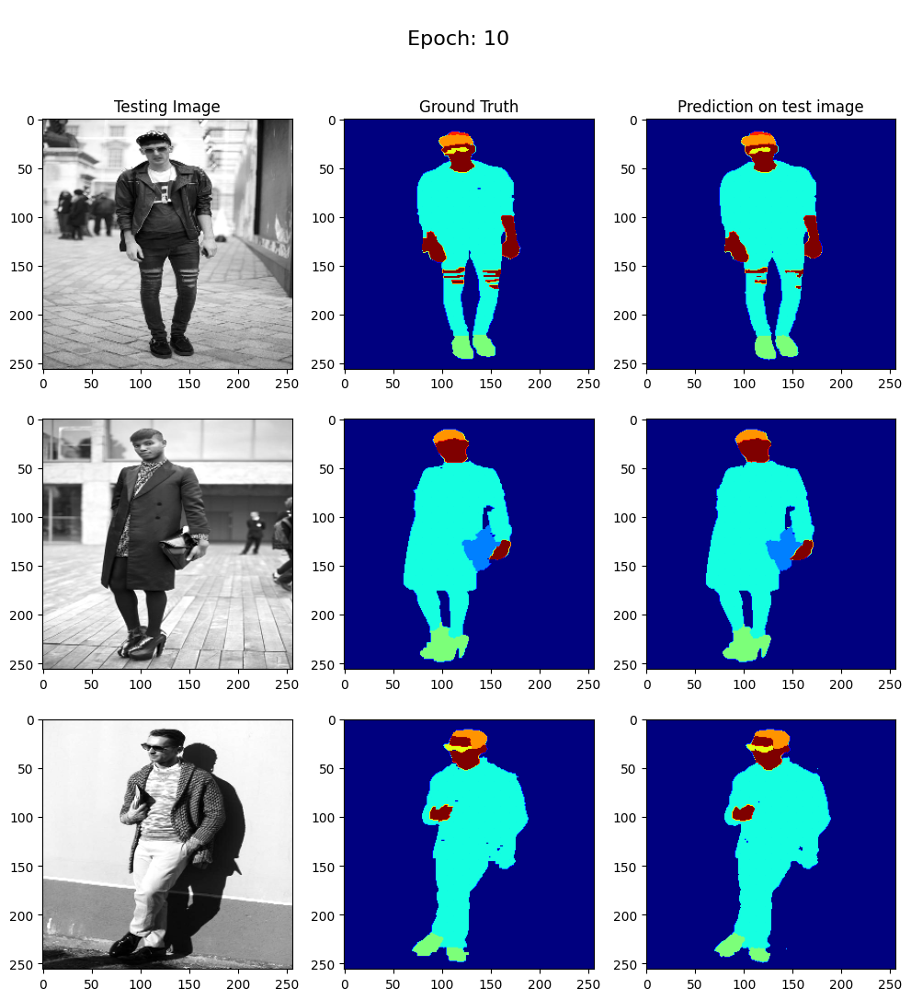

11
57/57 [==============================] - 10s 172ms/step - loss: 0.0114 - accuracy: 0.9956 - val_loss: 0.2451 - val_accuracy: 0.9561
Epoch 12/50
1/1 [==============================] - 0s 38ms/step


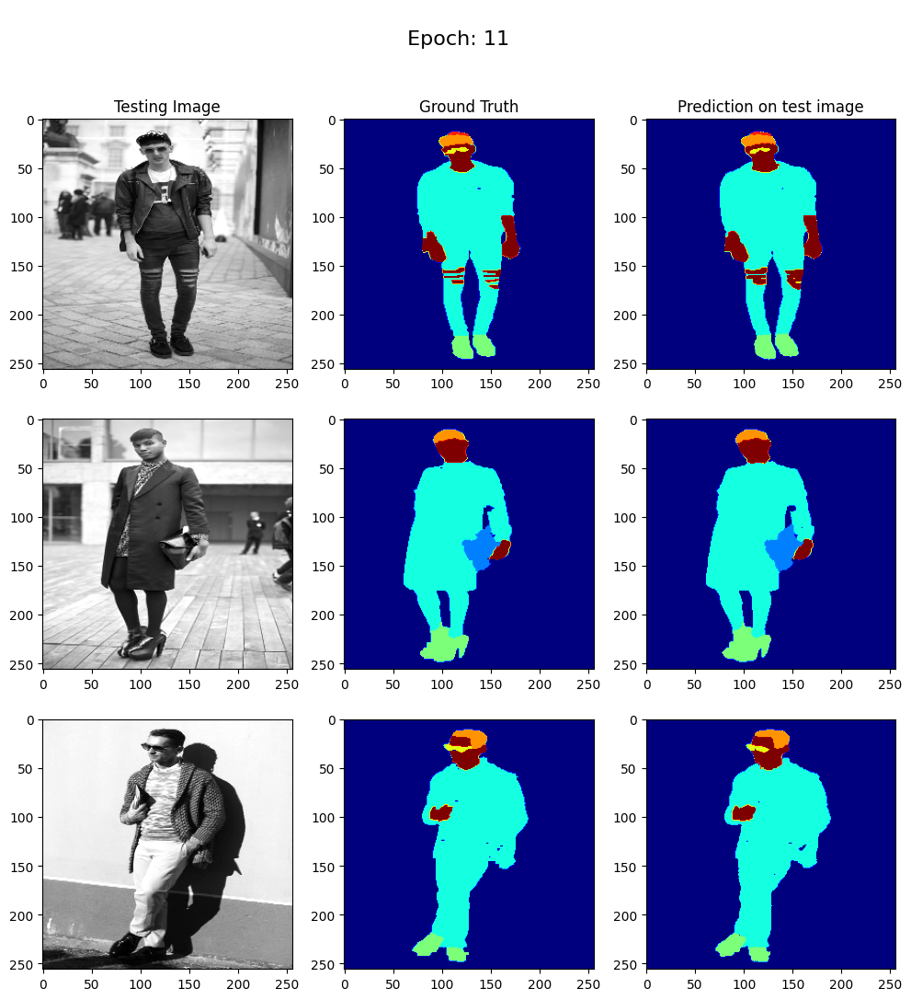

12
57/57 [==============================] - 11s 187ms/step - loss: 0.0116 - accuracy: 0.9955 - val_loss: 0.2395 - val_accuracy: 0.9556
Epoch 13/50
1/1 [==============================] - 0s 28ms/step


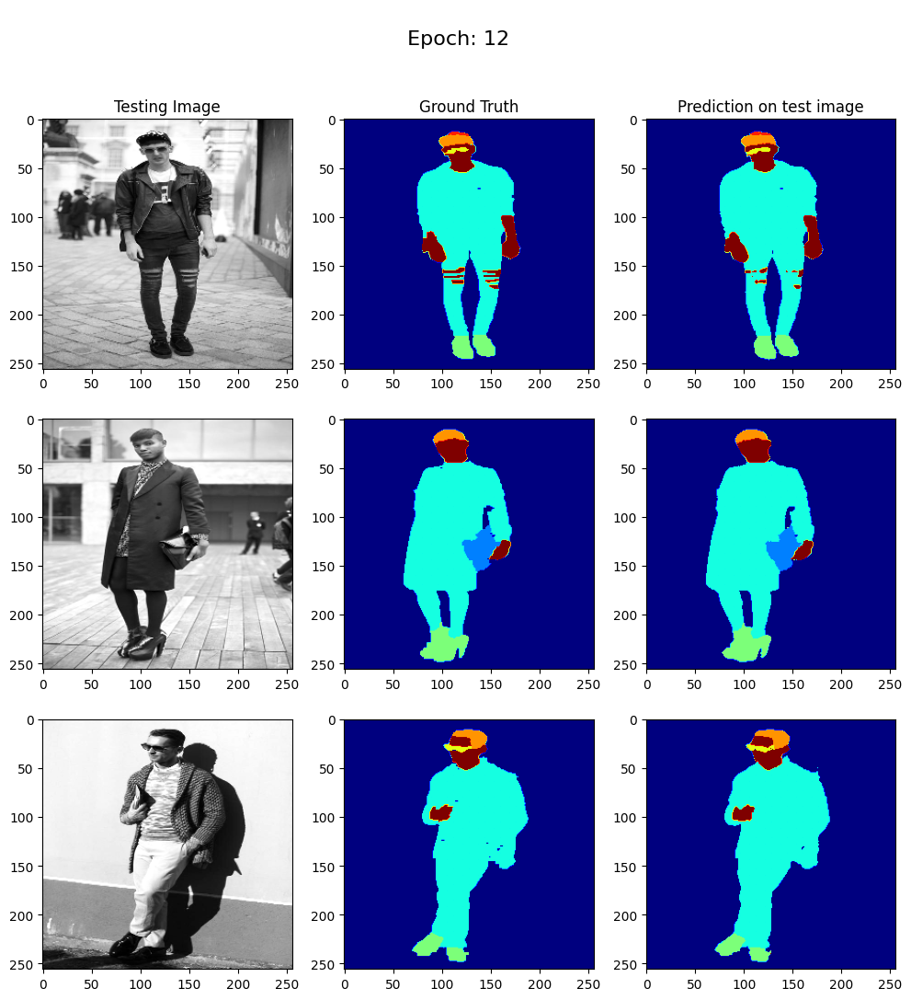

13
57/57 [==============================] - 10s 171ms/step - loss: 0.0113 - accuracy: 0.9956 - val_loss: 0.2509 - val_accuracy: 0.9560
Epoch 14/50
1/1 [==============================] - 0s 26ms/step


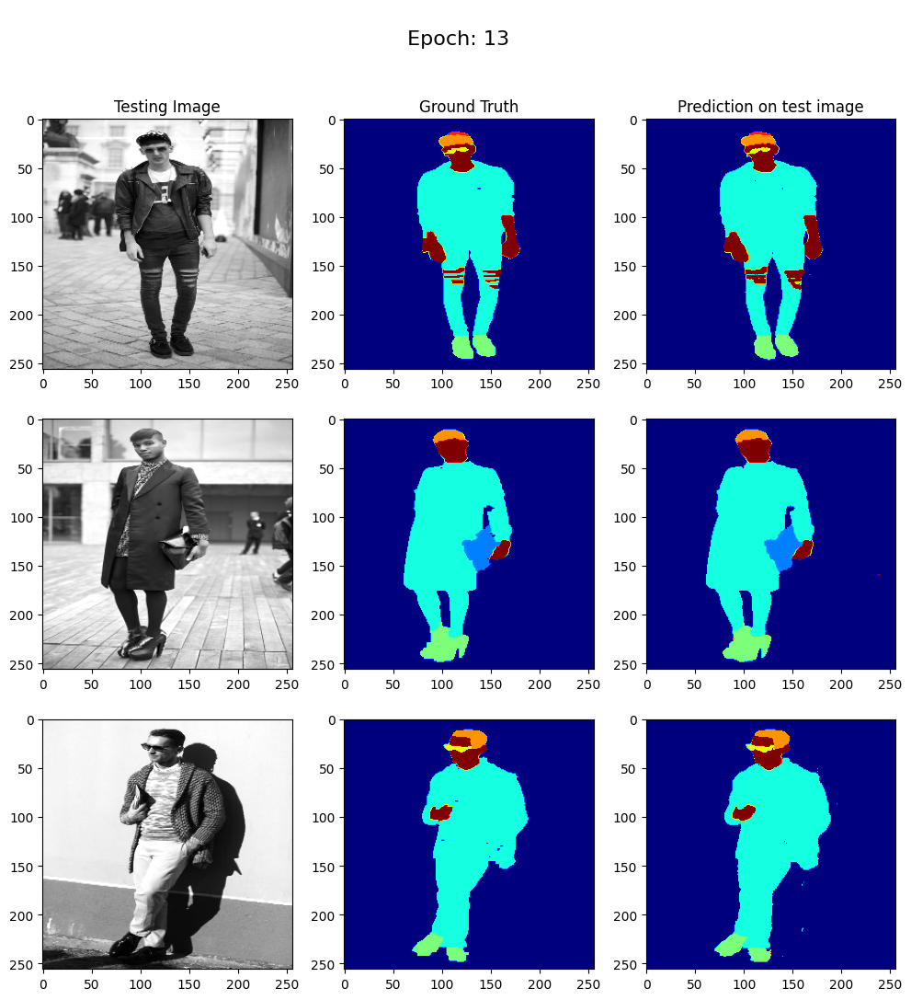

14
57/57 [==============================] - 10s 180ms/step - loss: 0.0111 - accuracy: 0.9956 - val_loss: 0.2507 - val_accuracy: 0.9558
Epoch 15/50
1/1 [==============================] - 0s 48ms/step


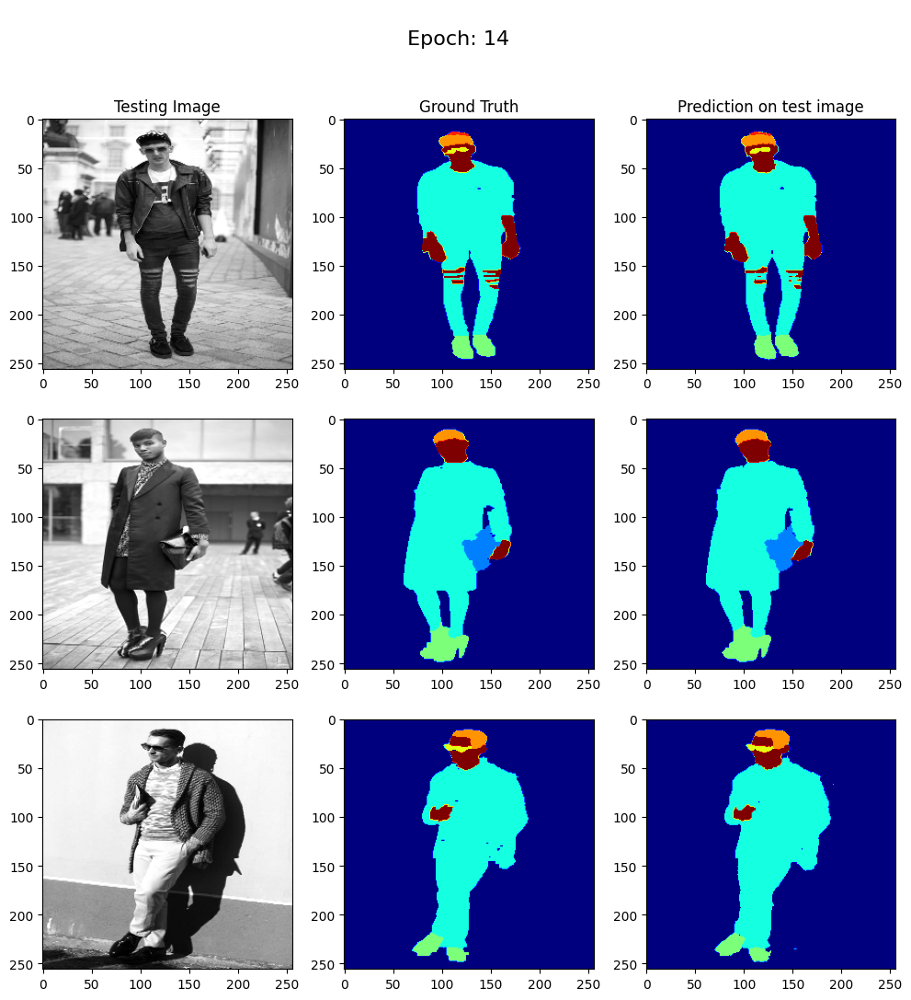

15
57/57 [==============================] - 11s 187ms/step - loss: 0.0115 - accuracy: 0.9955 - val_loss: 0.2510 - val_accuracy: 0.9562
Epoch 16/50
1/1 [==============================] - 0s 36ms/step


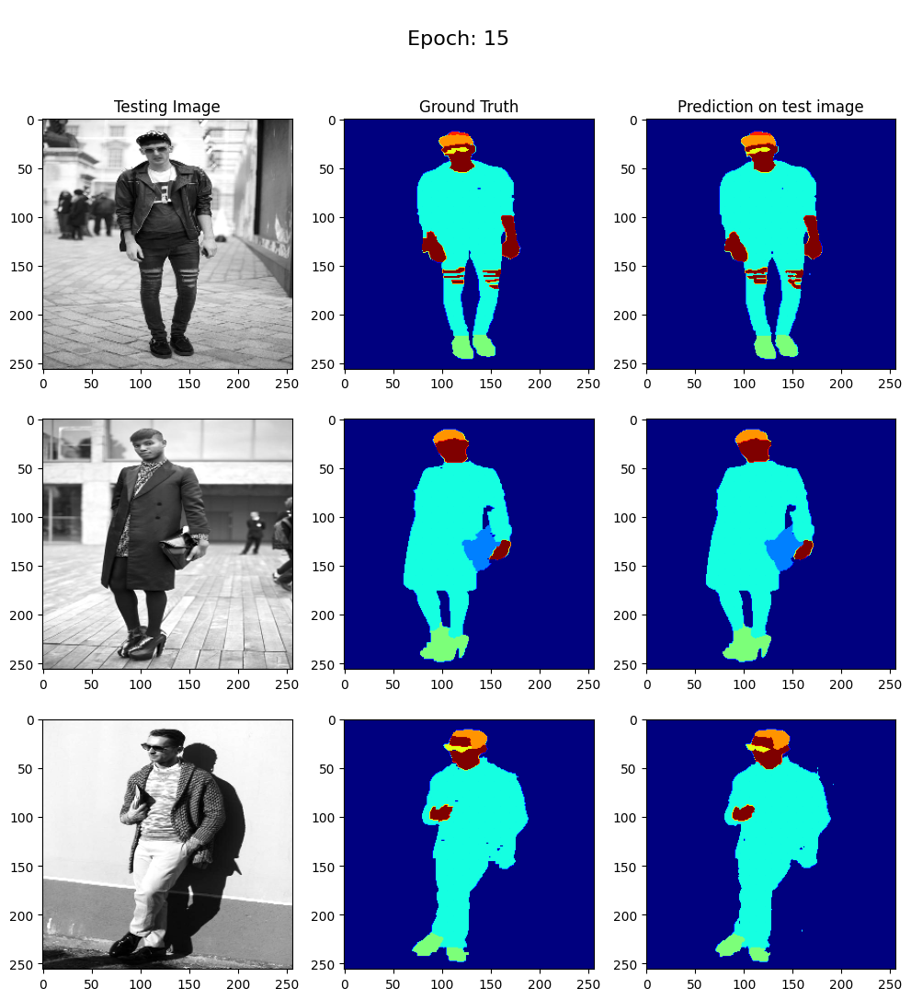

16
57/57 [==============================] - 10s 169ms/step - loss: 0.0114 - accuracy: 0.9955 - val_loss: 0.2566 - val_accuracy: 0.9560
Epoch 17/50
1/1 [==============================] - 0s 37ms/step


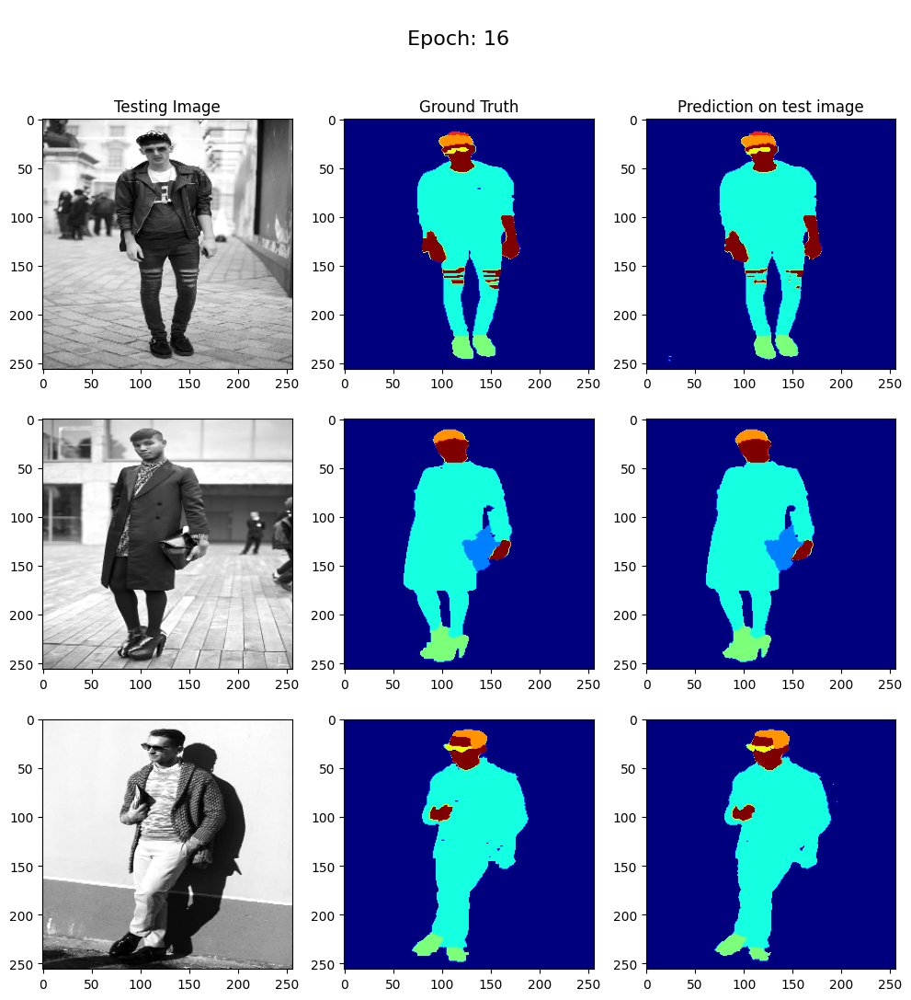

17
57/57 [==============================] - 10s 174ms/step - loss: 0.0115 - accuracy: 0.9955 - val_loss: 0.2516 - val_accuracy: 0.9558
Epoch 18/50
1/1 [==============================] - 0s 70ms/step


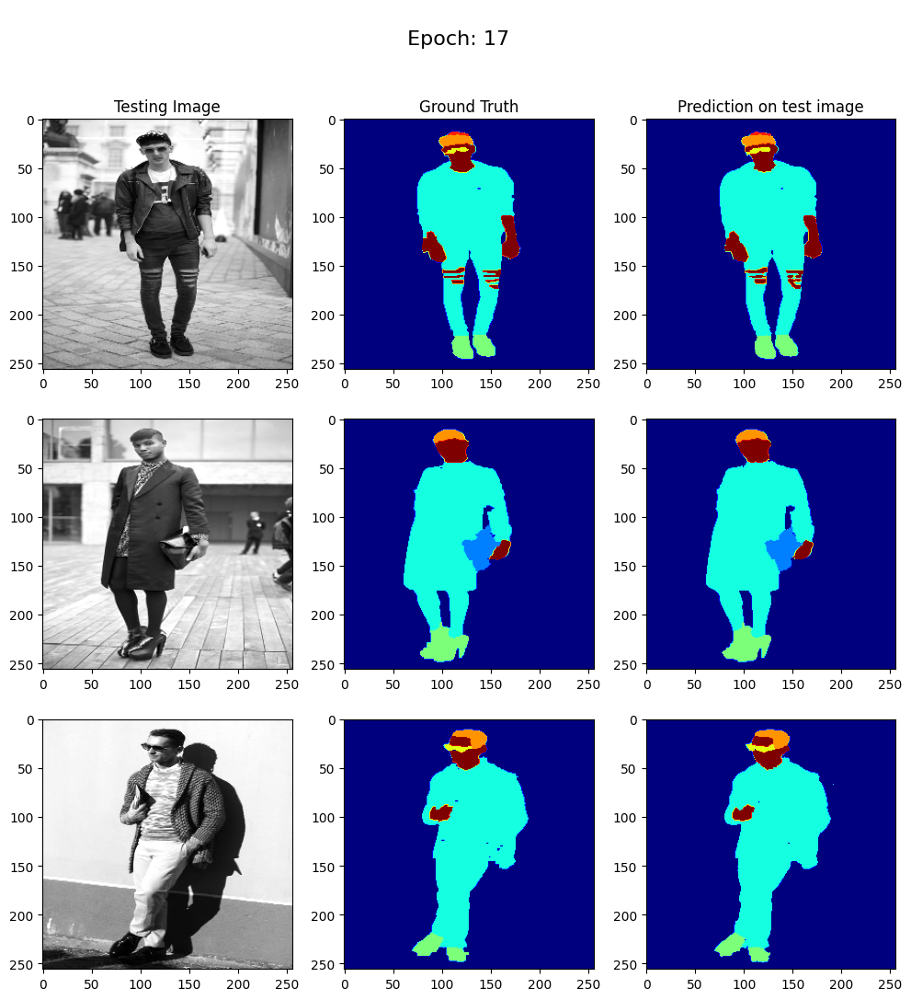

18
57/57 [==============================] - 11s 191ms/step - loss: 0.0113 - accuracy: 0.9956 - val_loss: 0.2605 - val_accuracy: 0.9562
Epoch 19/50
1/1 [==============================] - 0s 39ms/step


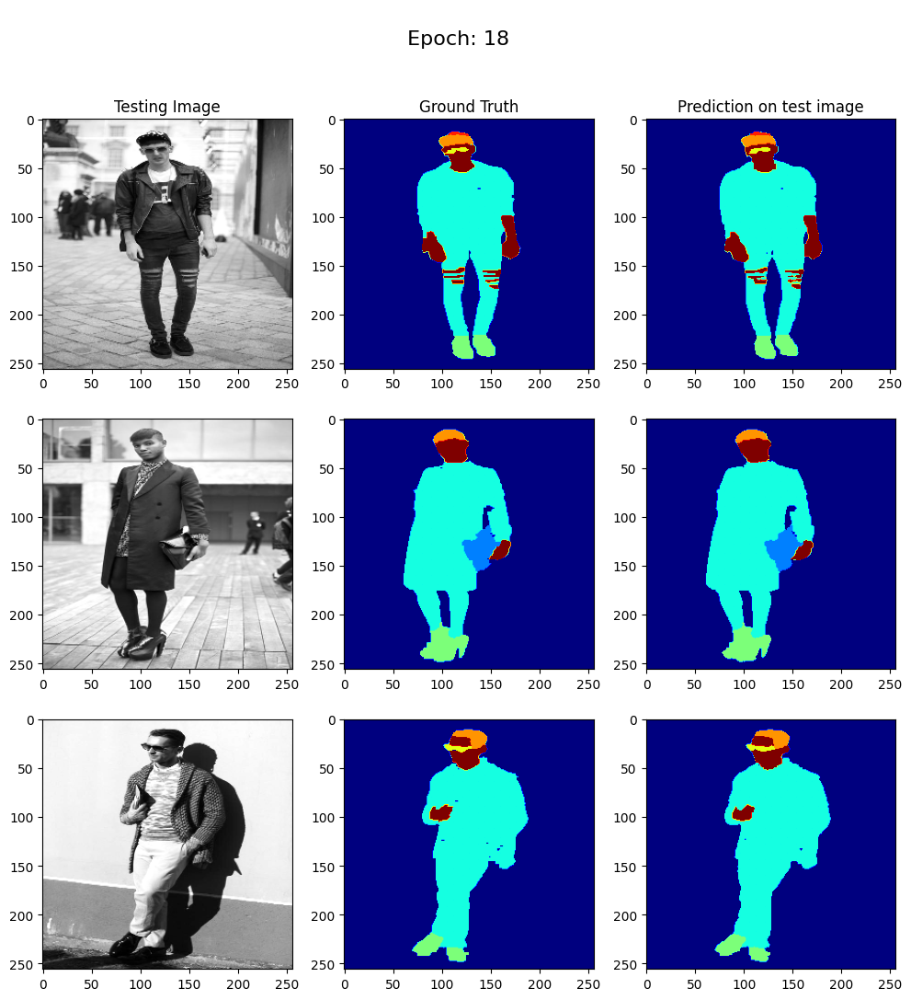

19
57/57 [==============================] - 11s 201ms/step - loss: 0.0108 - accuracy: 0.9958 - val_loss: 0.2512 - val_accuracy: 0.9563
Epoch 20/50
1/1 [==============================] - 0s 54ms/step


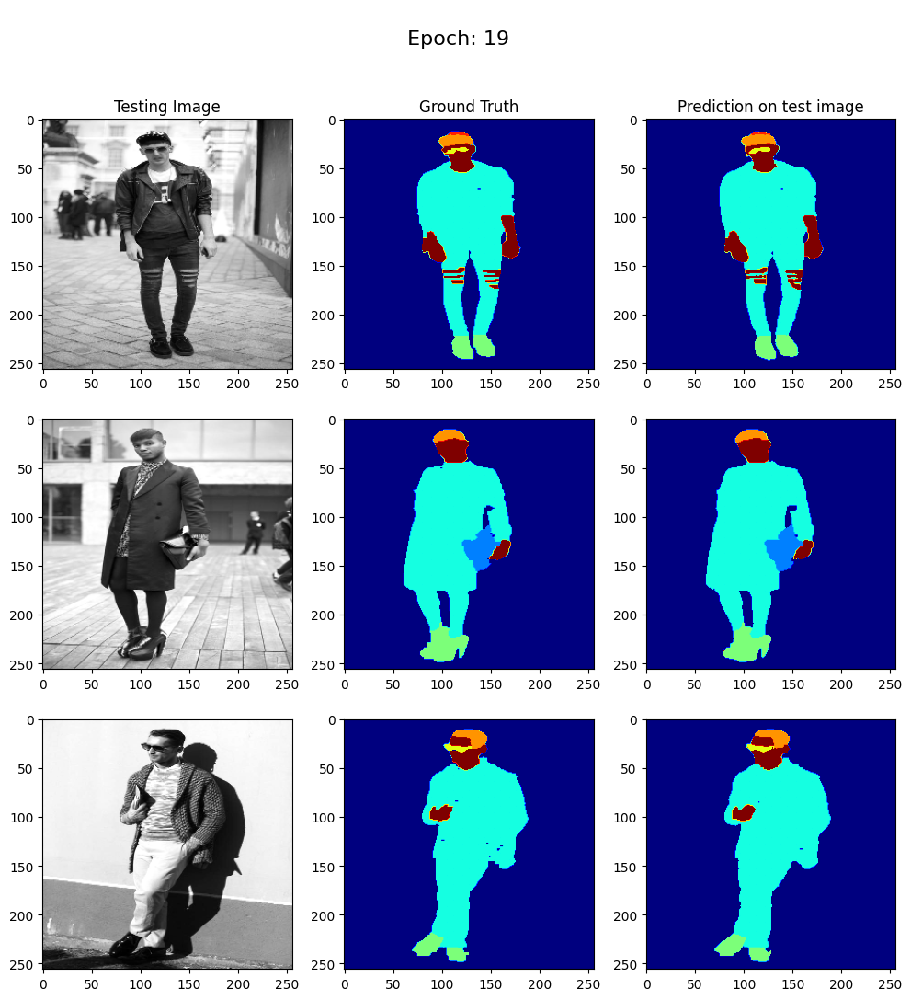

20
57/57 [==============================] - 10s 179ms/step - loss: 0.0104 - accuracy: 0.9959 - val_loss: 0.2510 - val_accuracy: 0.9561
Epoch 21/50
1/1 [==============================] - 0s 79ms/step


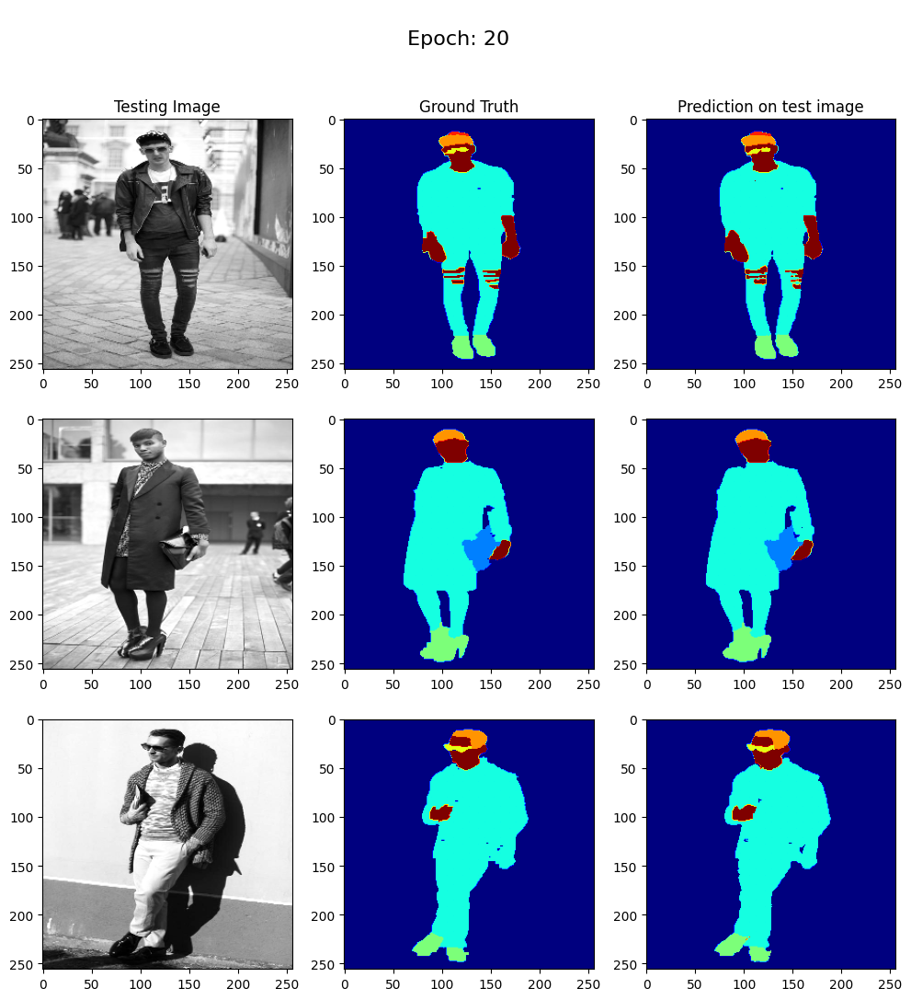

21
57/57 [==============================] - 11s 189ms/step - loss: 0.0103 - accuracy: 0.9960 - val_loss: 0.2524 - val_accuracy: 0.9551
Epoch 22/50
1/1 [==============================] - 0s 39ms/step


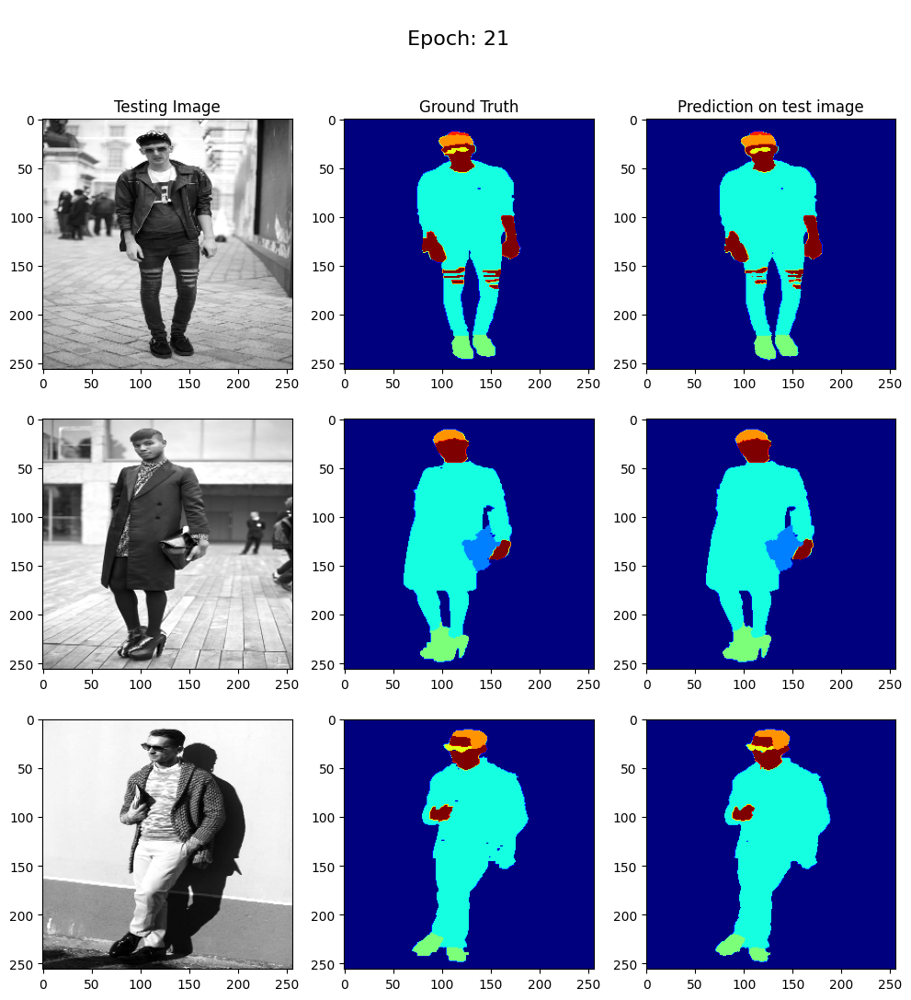

22
57/57 [==============================] - 10s 182ms/step - loss: 0.0108 - accuracy: 0.9958 - val_loss: 0.2638 - val_accuracy: 0.9563
Epoch 23/50
1/1 [==============================] - 0s 39ms/step


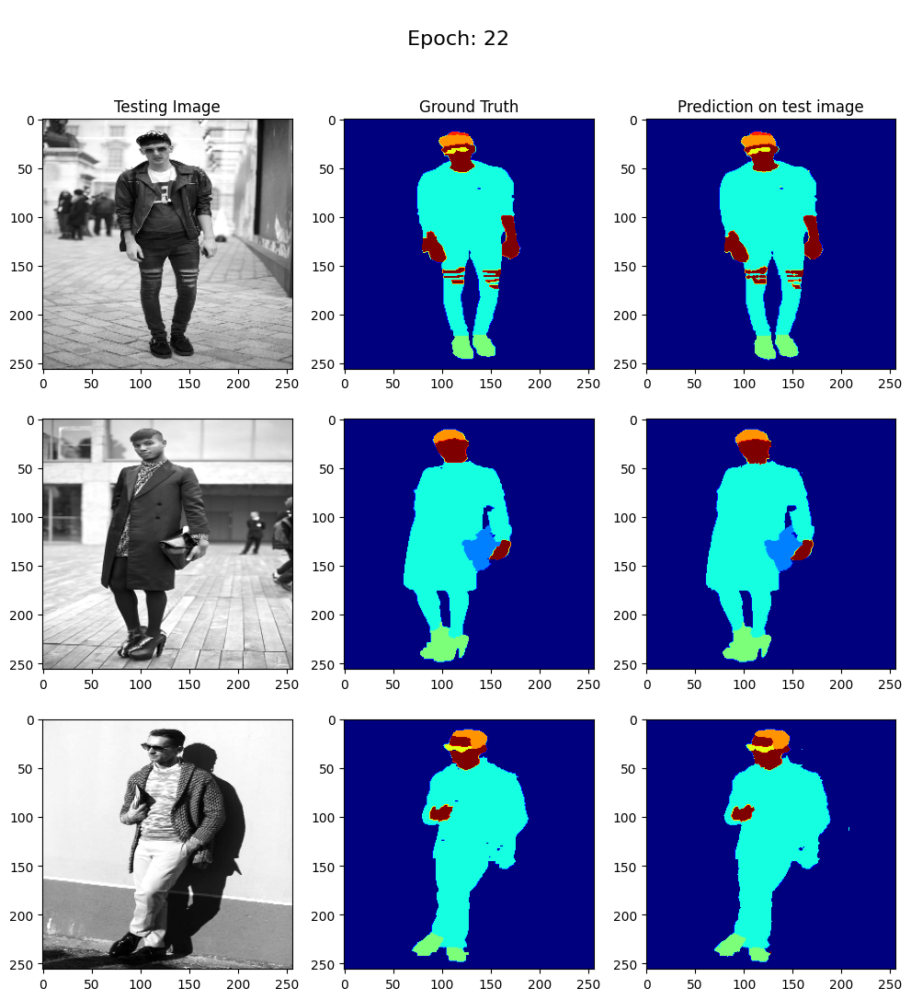

23
57/57 [==============================] - 11s 185ms/step - loss: 0.0108 - accuracy: 0.9958 - val_loss: 0.2568 - val_accuracy: 0.9557
Epoch 24/50
1/1 [==============================] - 0s 40ms/step


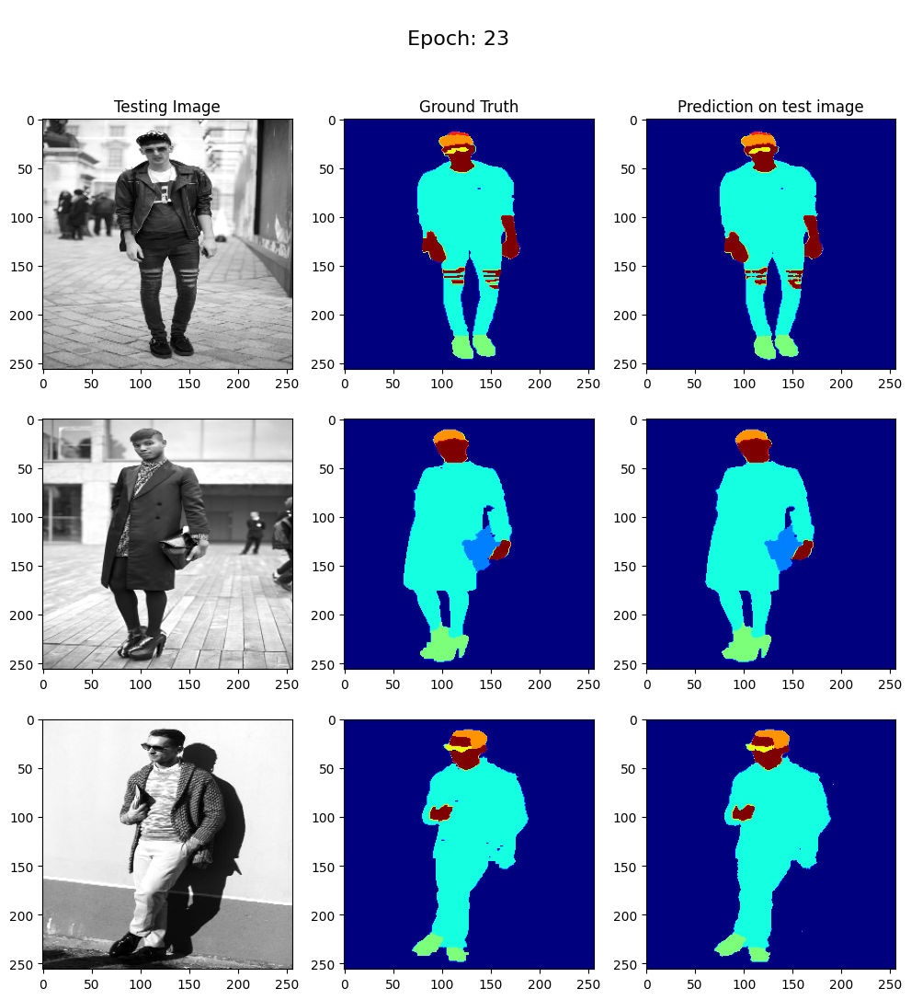

24
57/57 [==============================] - 12s 203ms/step - loss: 0.0103 - accuracy: 0.9960 - val_loss: 0.2660 - val_accuracy: 0.9563
Epoch 25/50
1/1 [==============================] - 0s 84ms/step


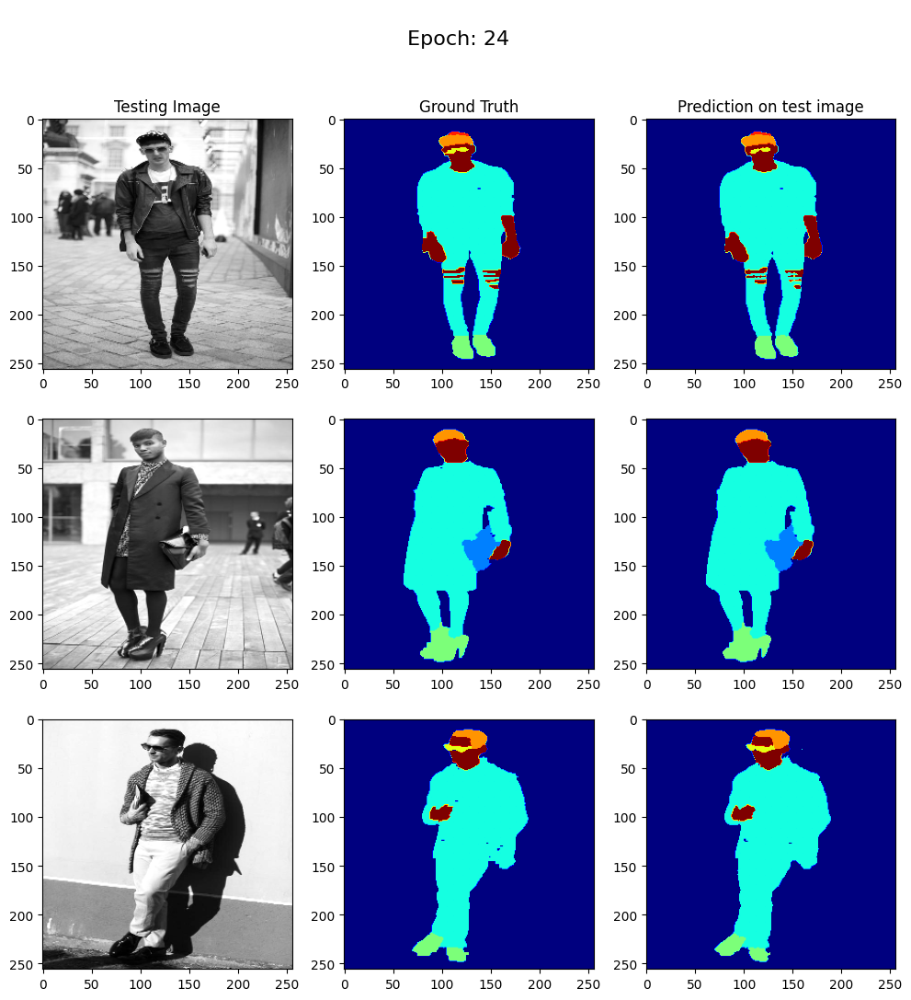

25
57/57 [==============================] - 11s 194ms/step - loss: 0.0098 - accuracy: 0.9962 - val_loss: 0.2687 - val_accuracy: 0.9562
Epoch 26/50
1/1 [==============================] - 0s 46ms/step


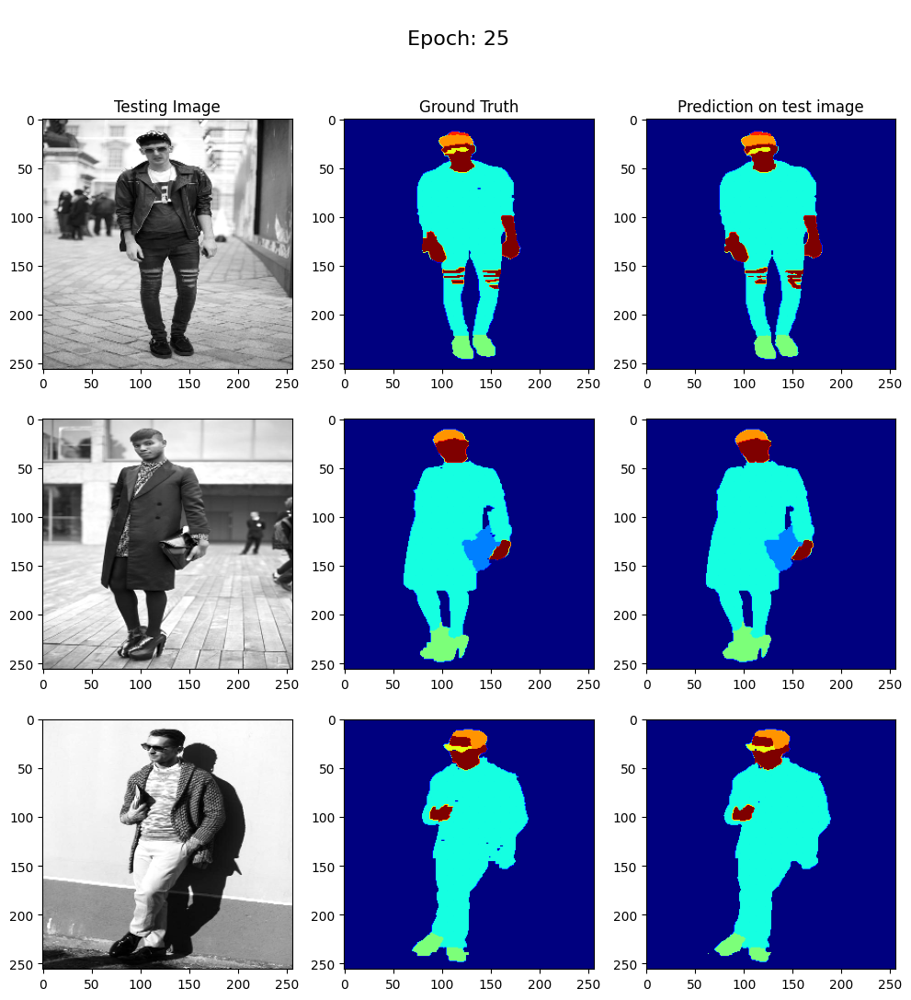

26
57/57 [==============================] - 11s 187ms/step - loss: 0.0094 - accuracy: 0.9964 - val_loss: 0.2632 - val_accuracy: 0.9566
Epoch 27/50
1/1 [==============================] - 0s 40ms/step


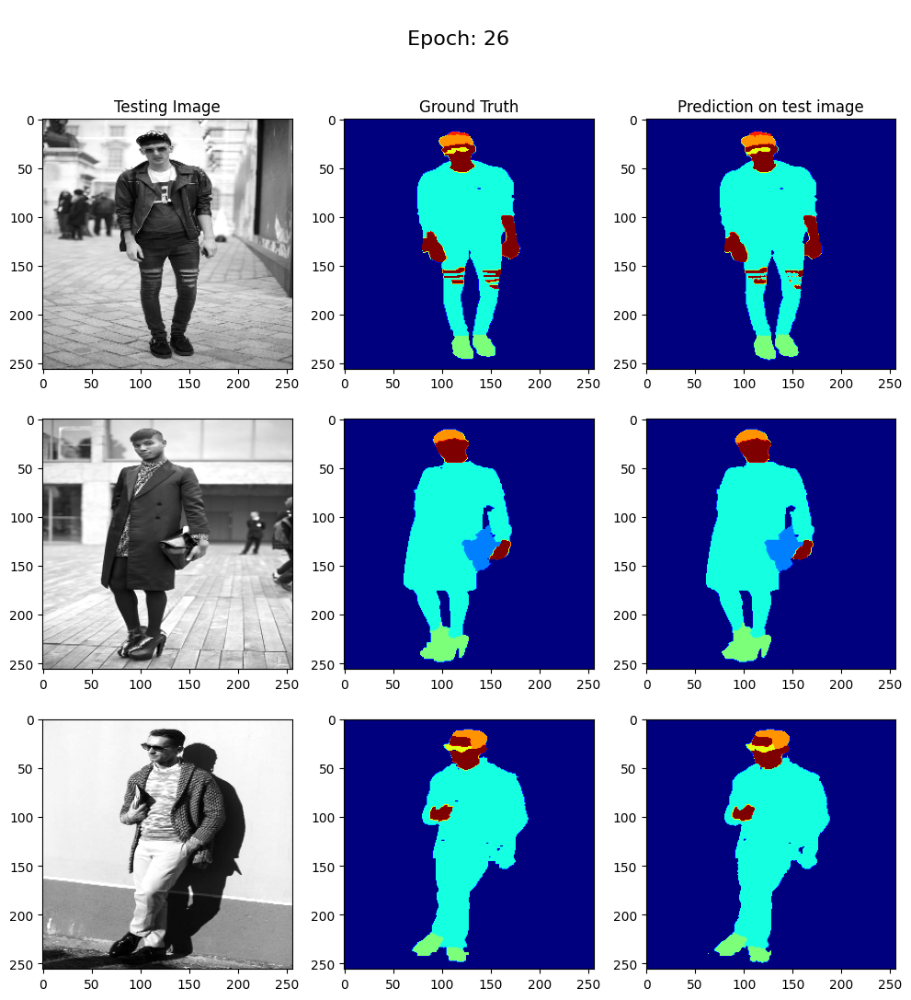

27
57/57 [==============================] - 11s 189ms/step - loss: 0.0090 - accuracy: 0.9965 - val_loss: 0.2655 - val_accuracy: 0.9560
Epoch 28/50
1/1 [==============================] - 0s 57ms/step


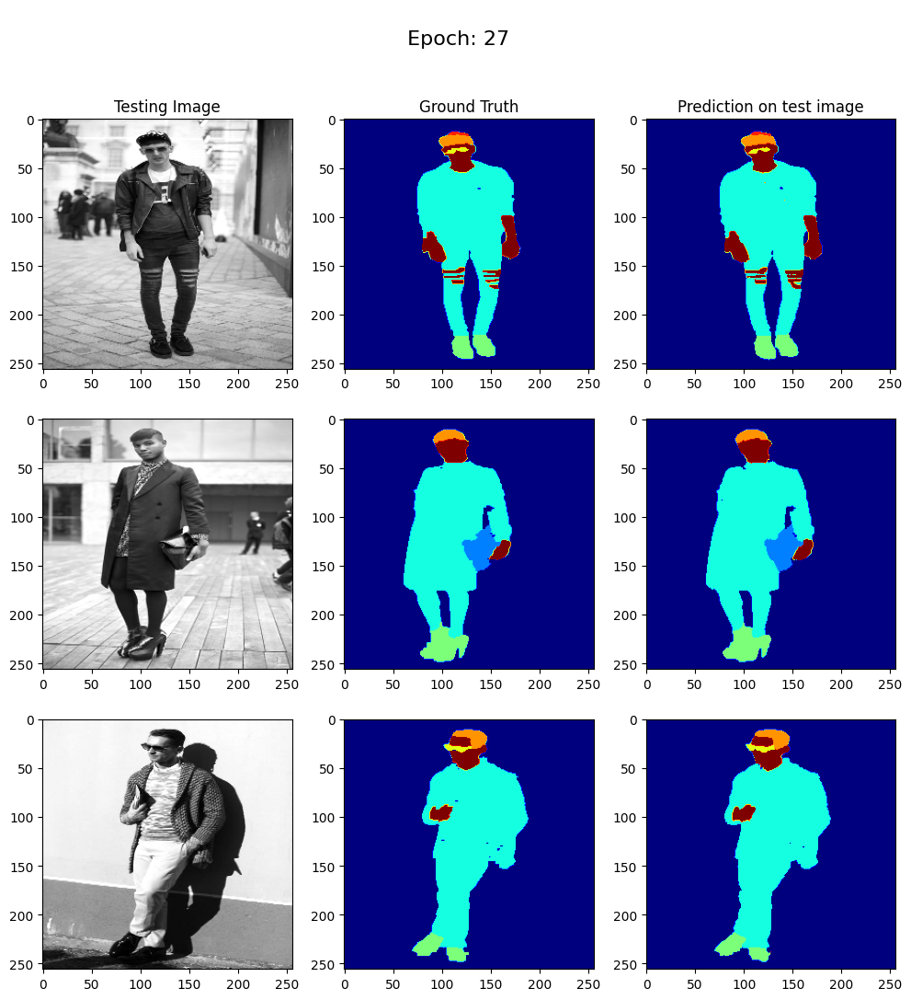

28
57/57 [==============================] - 11s 186ms/step - loss: 0.0097 - accuracy: 0.9962 - val_loss: 0.2647 - val_accuracy: 0.9553
Epoch 29/50
1/1 [==============================] - 0s 59ms/step


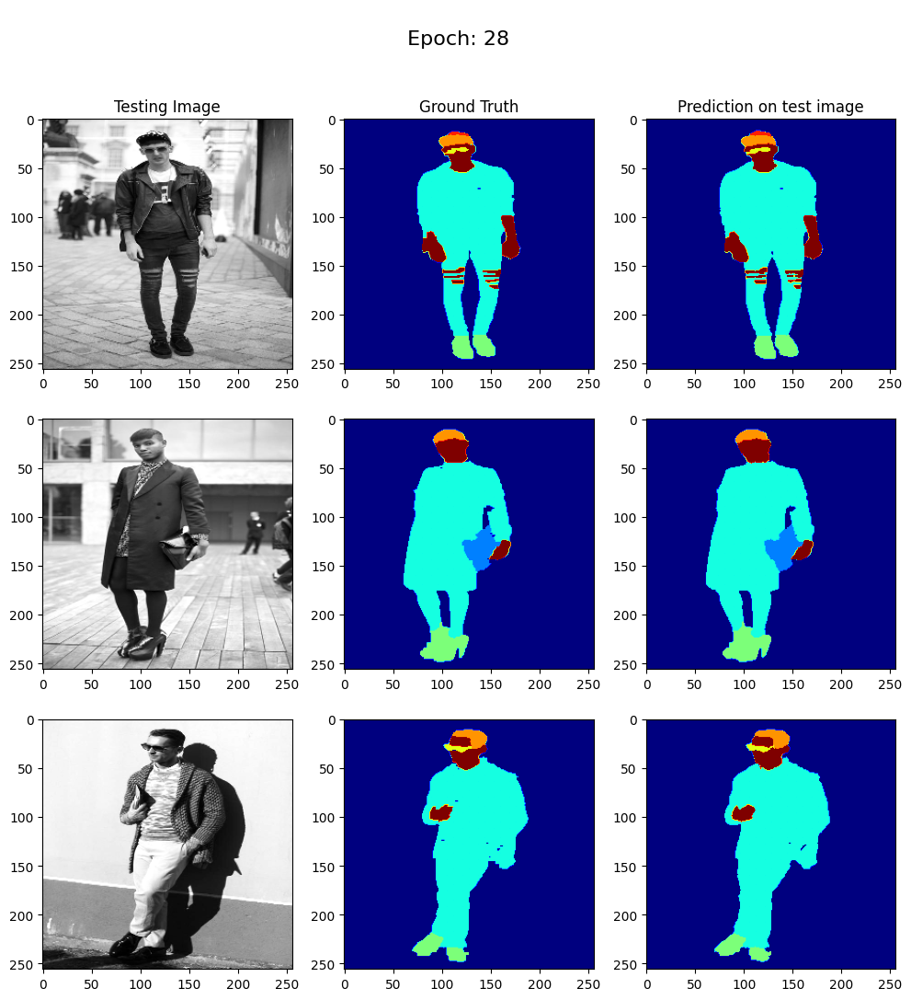

29
57/57 [==============================] - 11s 188ms/step - loss: 0.0101 - accuracy: 0.9960 - val_loss: 0.2697 - val_accuracy: 0.9558
Epoch 30/50
1/1 [==============================] - 0s 43ms/step


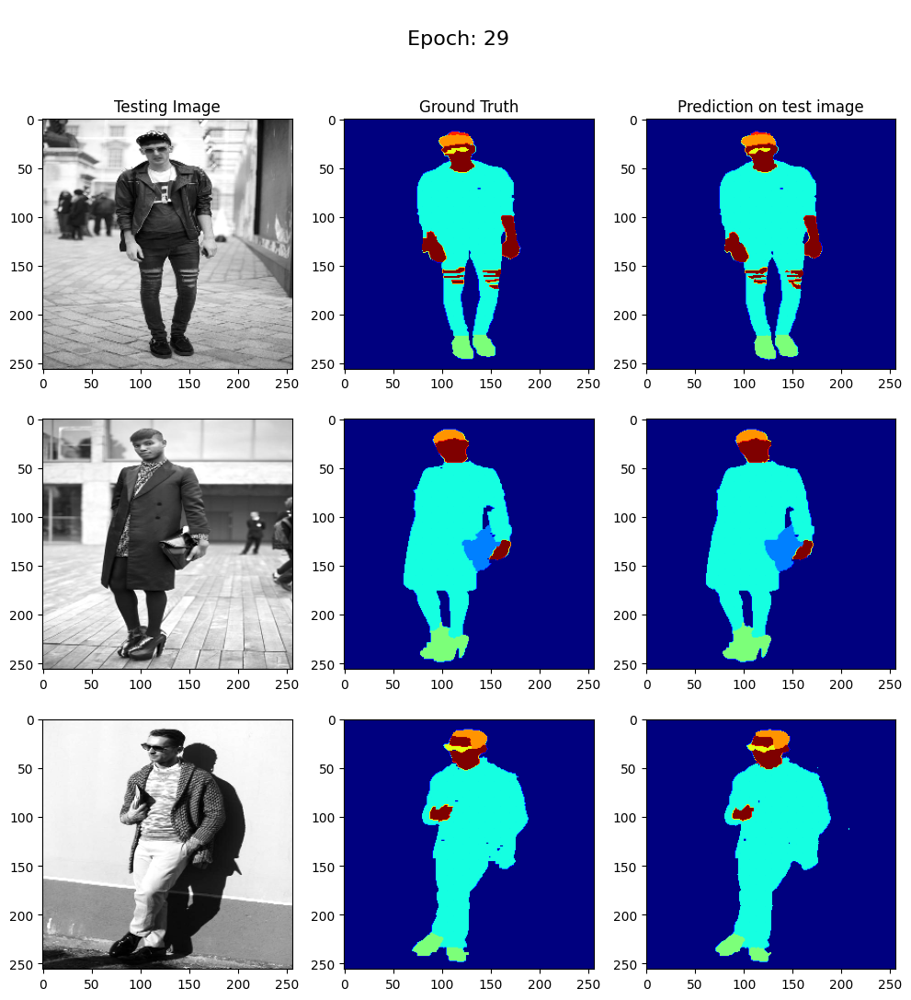

30
57/57 [==============================] - 12s 204ms/step - loss: 0.0098 - accuracy: 0.9962 - val_loss: 0.2735 - val_accuracy: 0.9562
Epoch 31/50
1/1 [==============================] - 0s 47ms/step


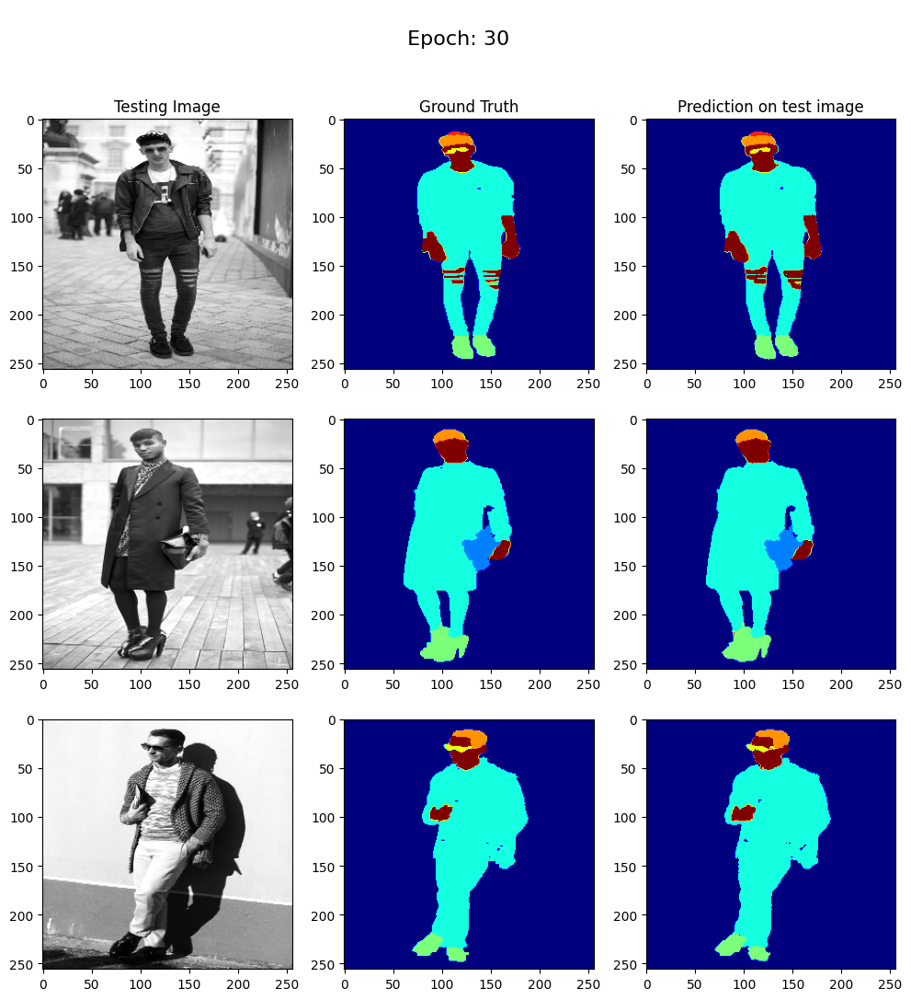

31
57/57 [==============================] - 11s 195ms/step - loss: 0.0089 - accuracy: 0.9965 - val_loss: 0.2672 - val_accuracy: 0.9557
Epoch 32/50
1/1 [==============================] - 0s 40ms/step


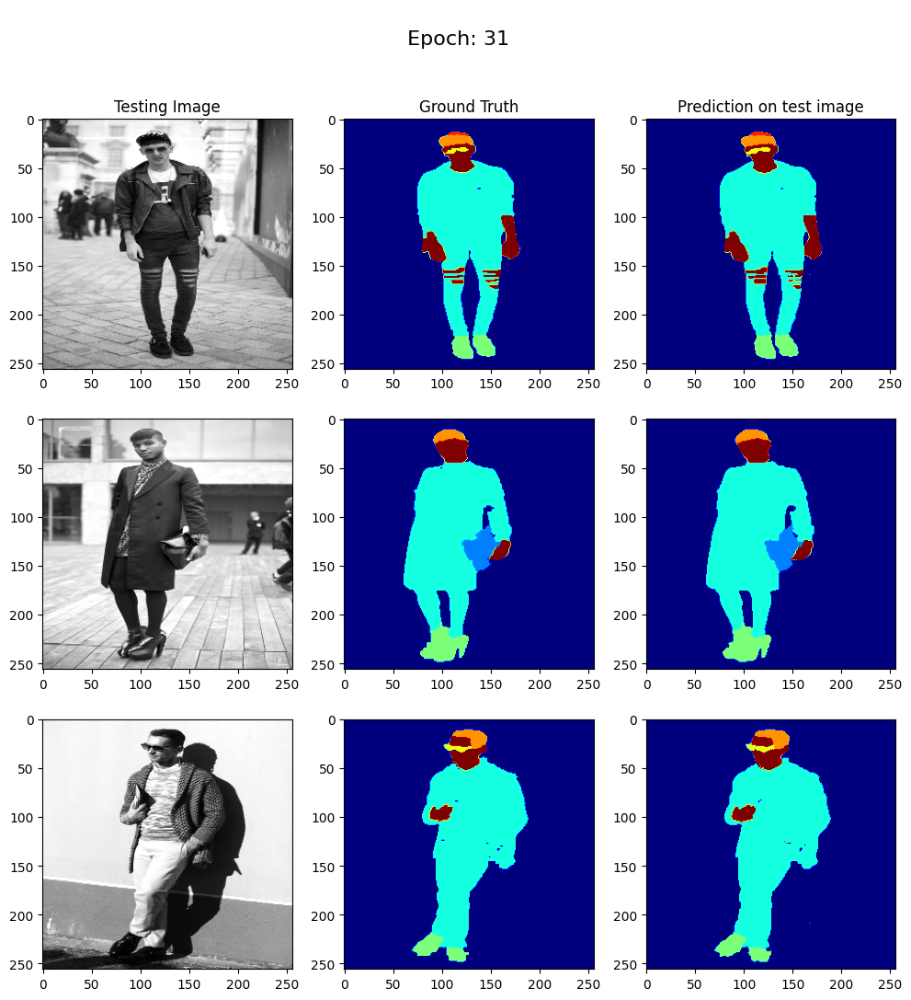

32
57/57 [==============================] - 11s 187ms/step - loss: 0.0091 - accuracy: 0.9965 - val_loss: 0.2646 - val_accuracy: 0.9557
Epoch 33/50
1/1 [==============================] - 0s 41ms/step


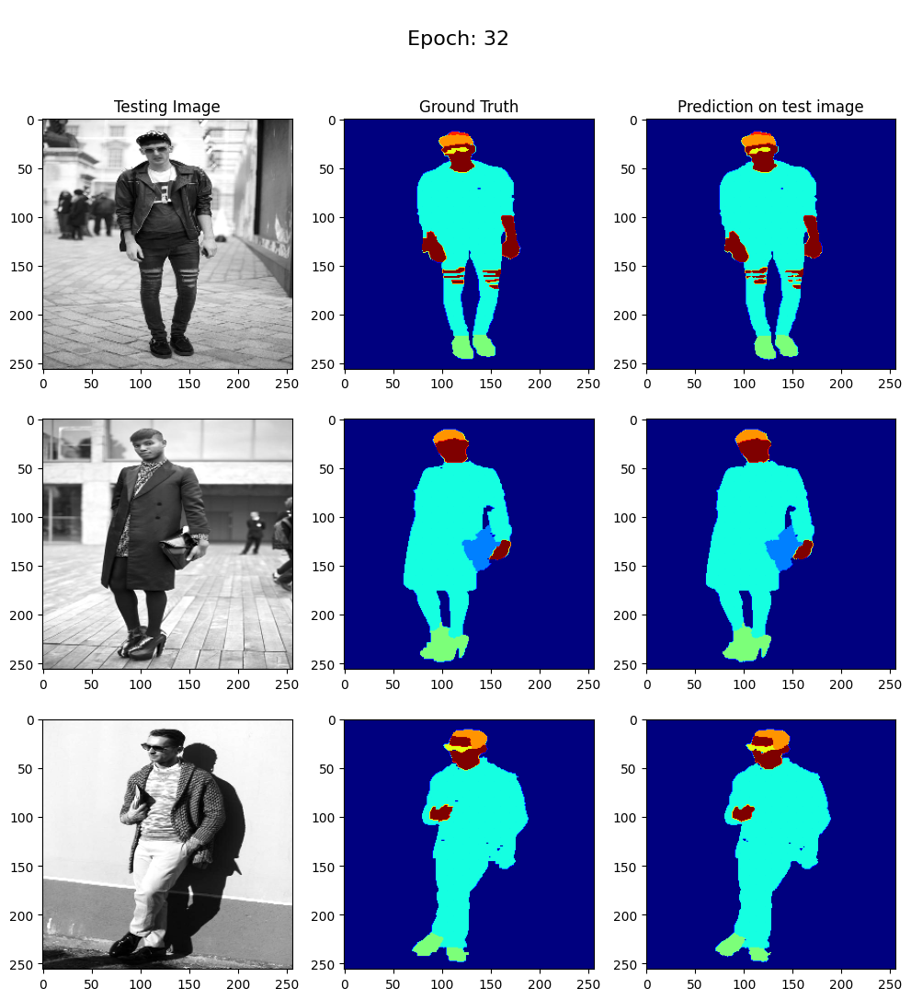

33
57/57 [==============================] - 11s 188ms/step - loss: 0.0088 - accuracy: 0.9966 - val_loss: 0.2725 - val_accuracy: 0.9561
Epoch 34/50
1/1 [==============================] - 0s 45ms/step


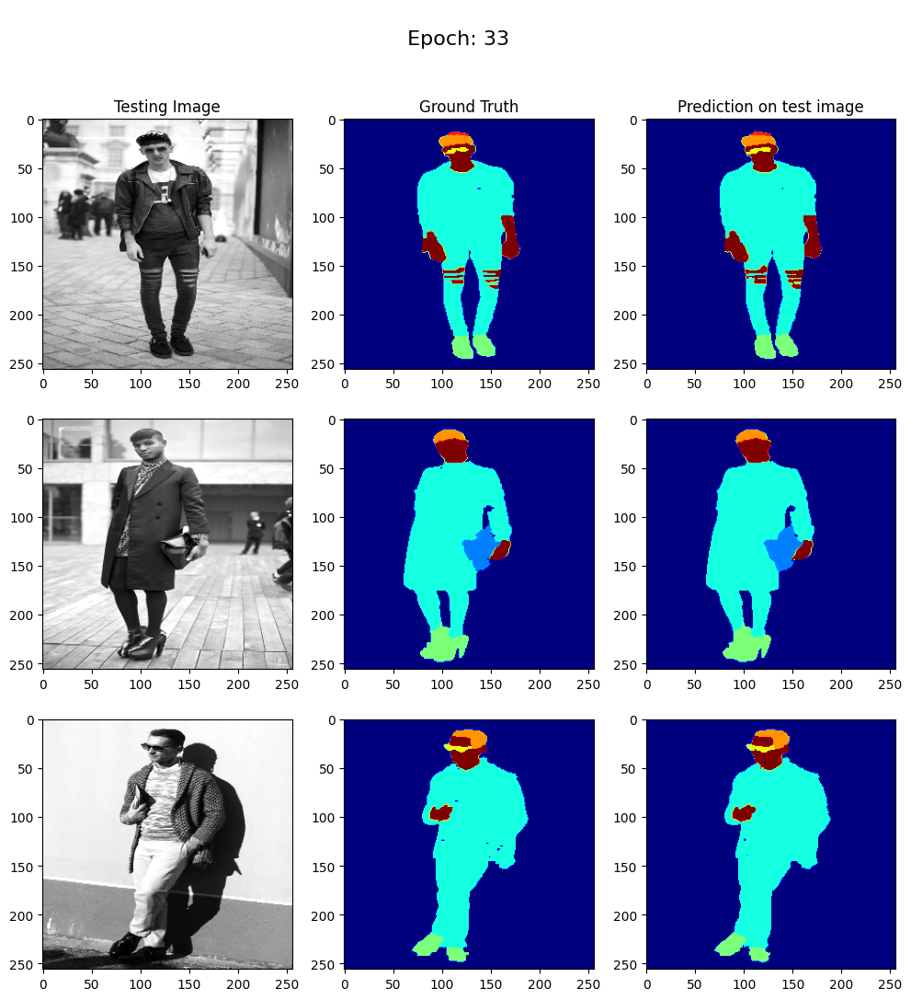

34
57/57 [==============================] - 11s 197ms/step - loss: 0.0091 - accuracy: 0.9965 - val_loss: 0.2689 - val_accuracy: 0.9557
Epoch 35/50
1/1 [==============================] - 0s 44ms/step


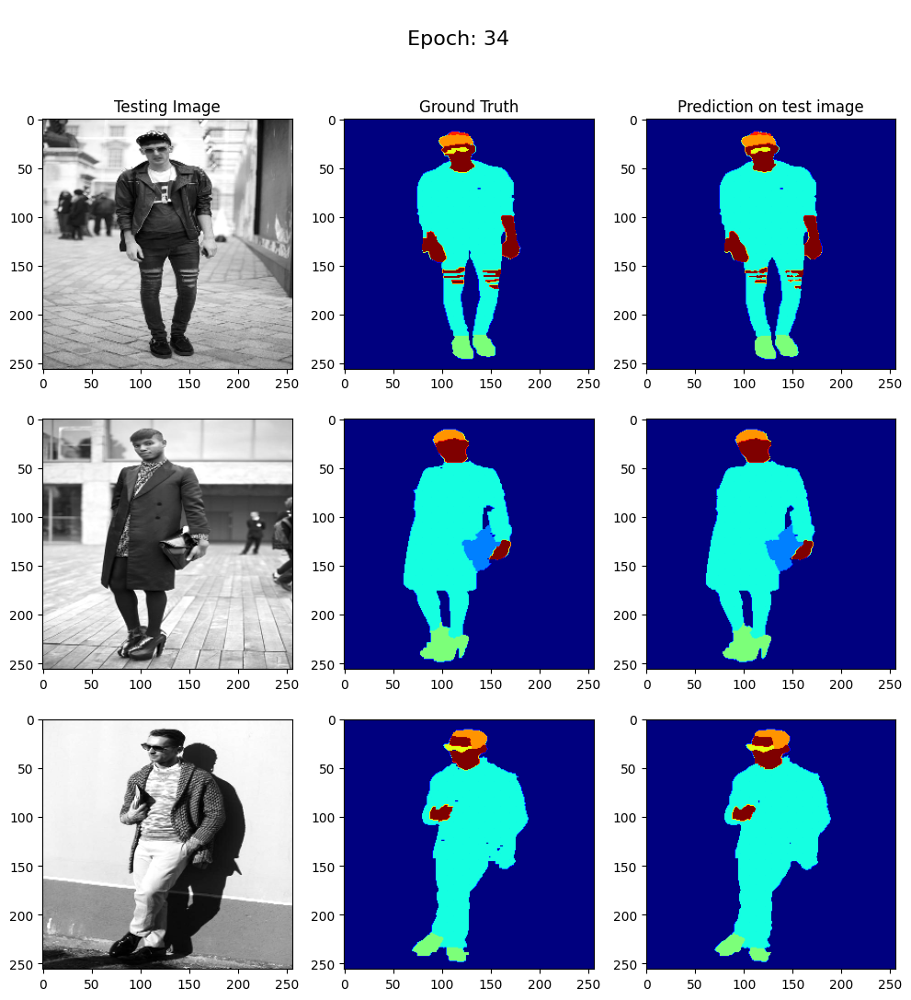

35
57/57 [==============================] - 11s 198ms/step - loss: 0.0091 - accuracy: 0.9965 - val_loss: 0.2722 - val_accuracy: 0.9562
Epoch 36/50
1/1 [==============================] - 0s 38ms/step


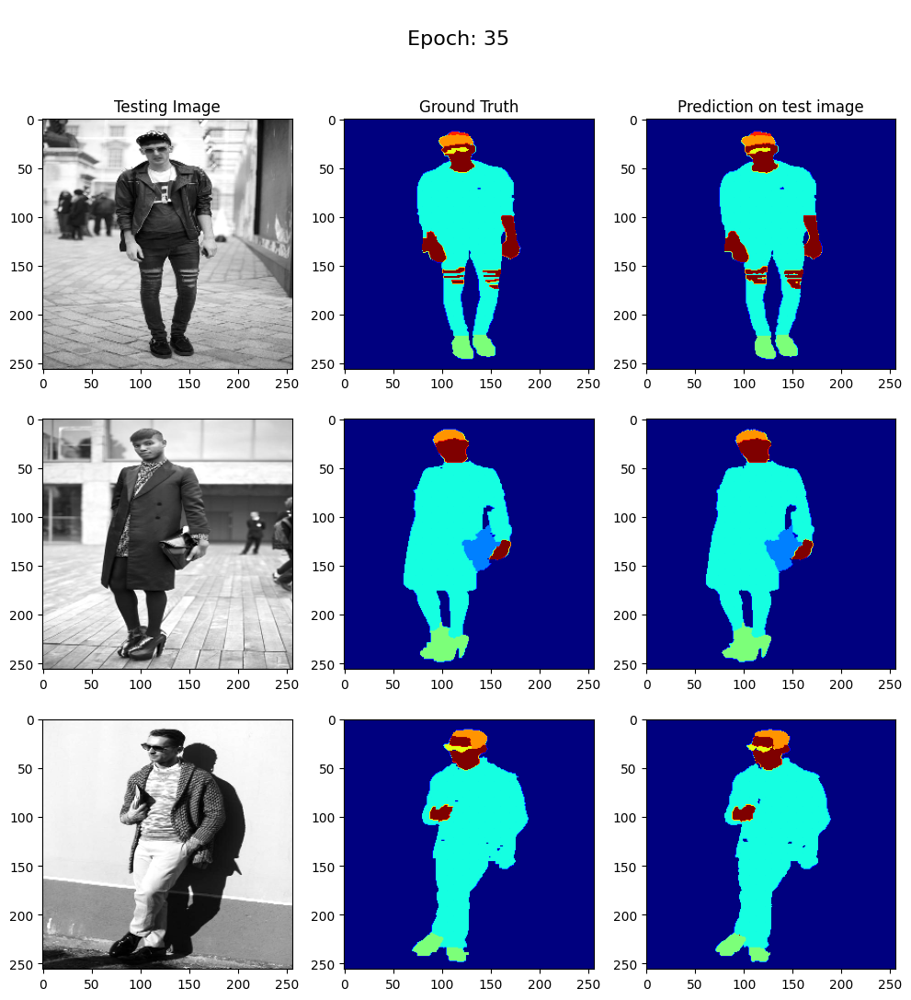

36
57/57 [==============================] - 11s 185ms/step - loss: 0.0085 - accuracy: 0.9967 - val_loss: 0.2815 - val_accuracy: 0.9550
Epoch 37/50
1/1 [==============================] - 0s 78ms/step


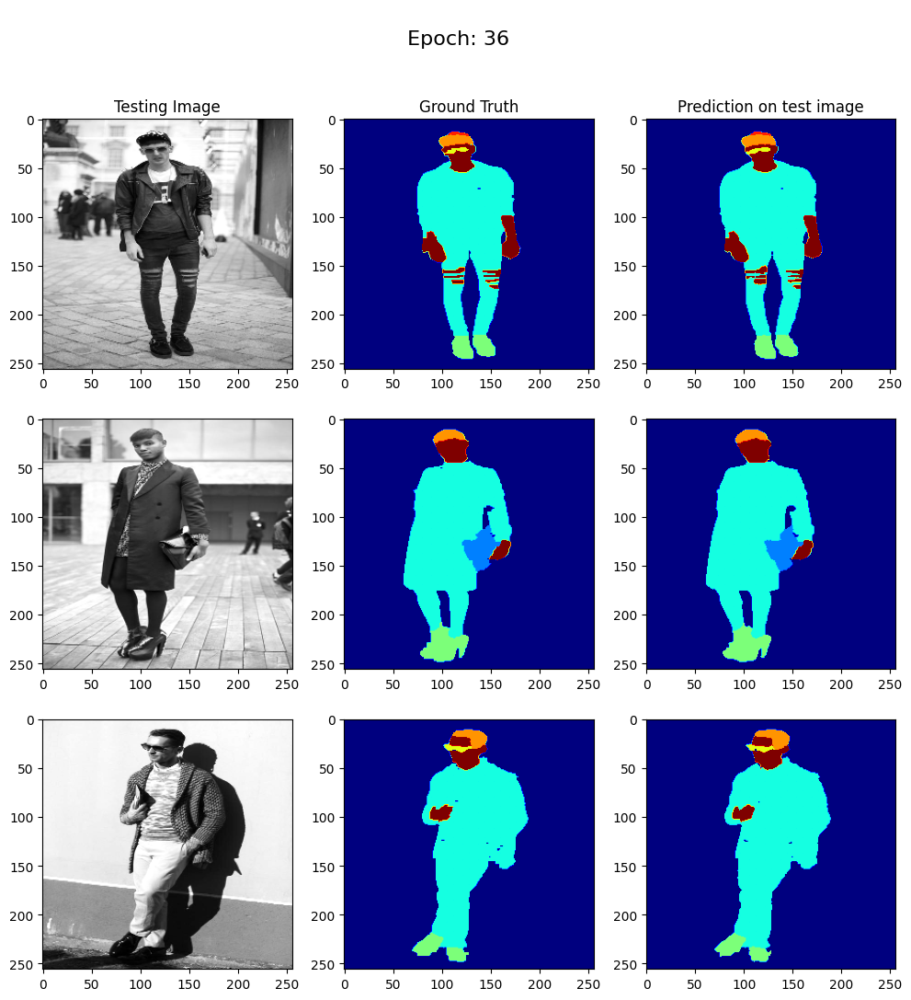

37
57/57 [==============================] - 11s 192ms/step - loss: 0.0088 - accuracy: 0.9966 - val_loss: 0.2838 - val_accuracy: 0.9560
Epoch 38/50
1/1 [==============================] - 0s 40ms/step


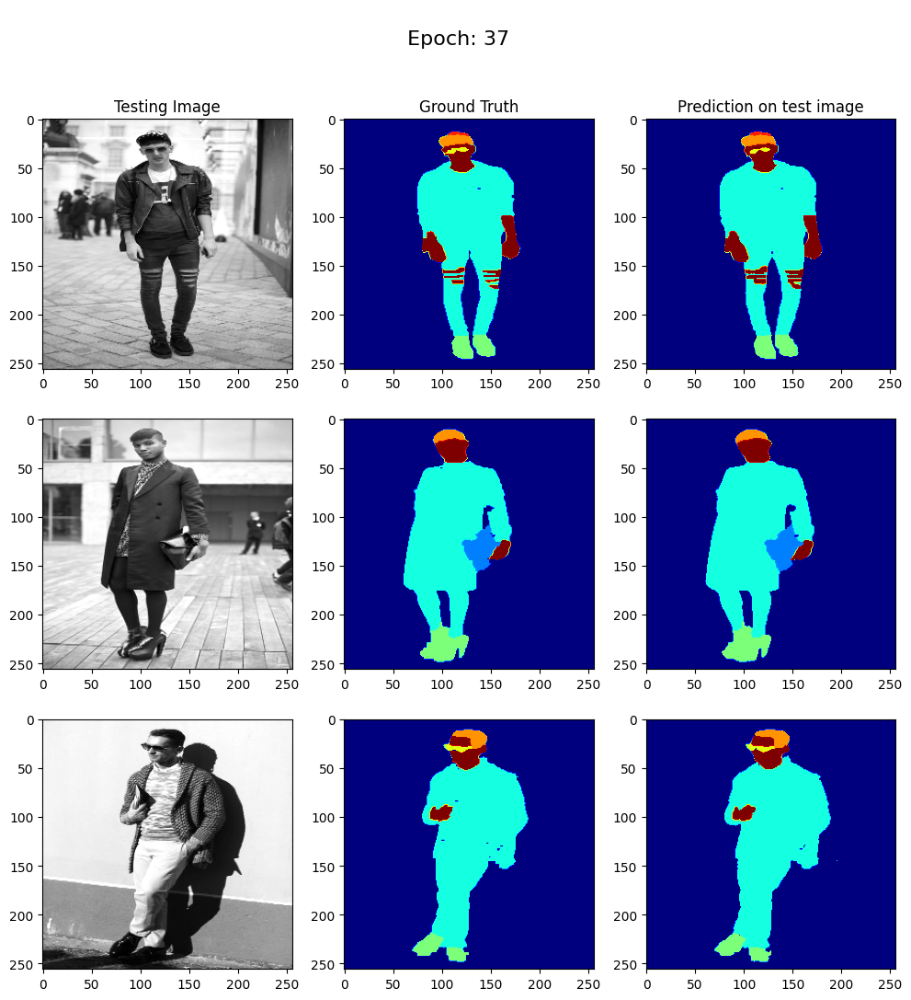

38
57/57 [==============================] - 11s 188ms/step - loss: 0.0090 - accuracy: 0.9965 - val_loss: 0.2824 - val_accuracy: 0.9562
Epoch 39/50
1/1 [==============================] - 0s 40ms/step


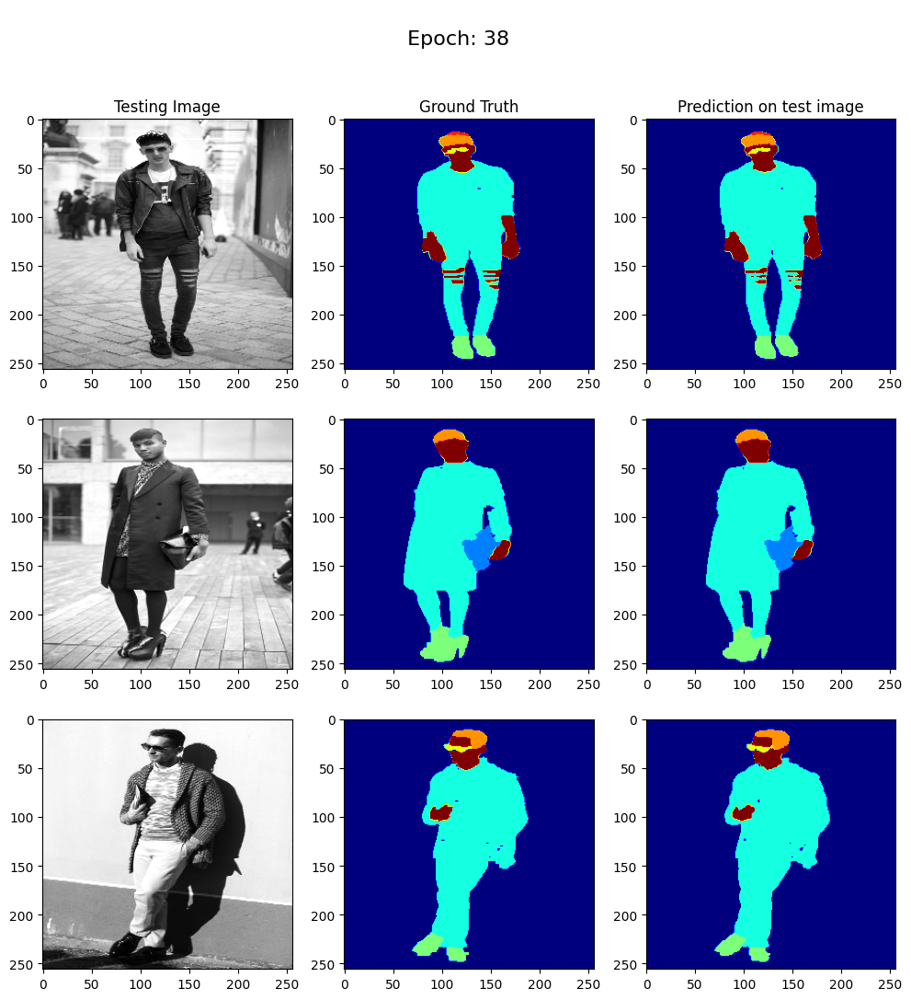

39
57/57 [==============================] - 11s 188ms/step - loss: 0.0088 - accuracy: 0.9966 - val_loss: 0.2850 - val_accuracy: 0.9563
Epoch 40/50
1/1 [==============================] - 0s 42ms/step


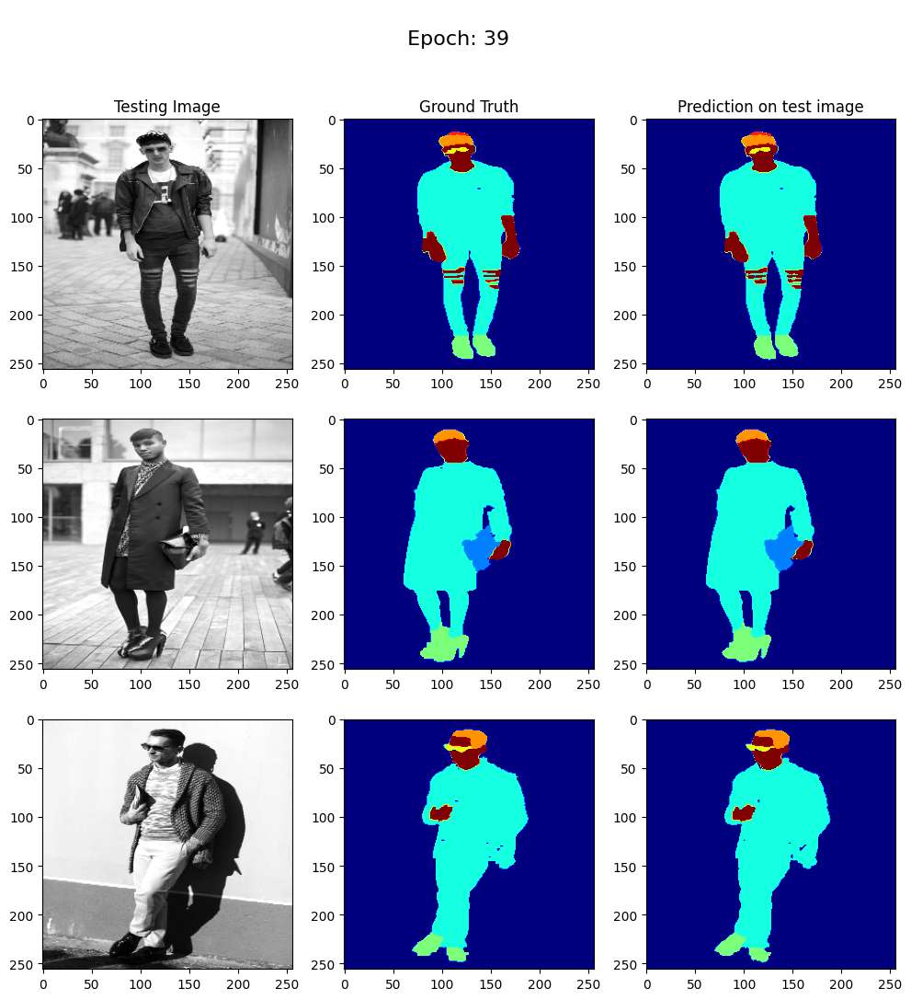

40
57/57 [==============================] - 12s 204ms/step - loss: 0.0081 - accuracy: 0.9968 - val_loss: 0.2757 - val_accuracy: 0.9558
Epoch 41/50
1/1 [==============================] - 0s 38ms/step


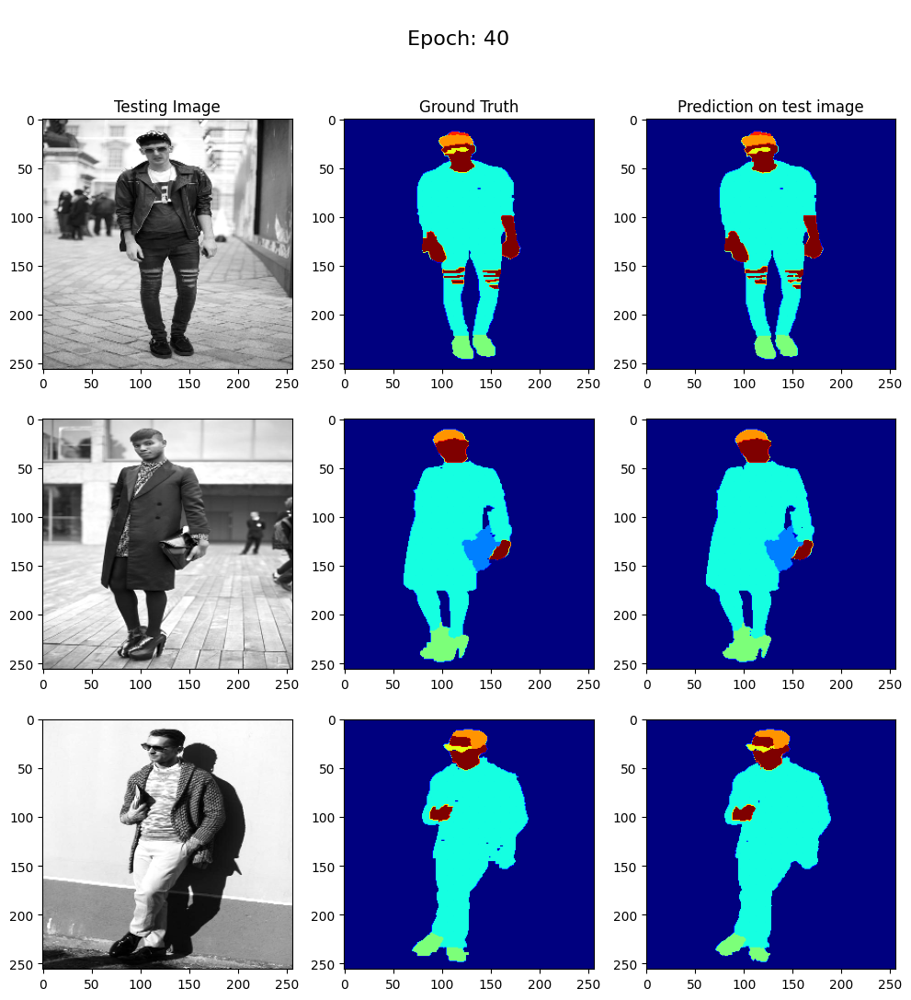

41
57/57 [==============================] - 11s 187ms/step - loss: 0.0077 - accuracy: 0.9970 - val_loss: 0.2857 - val_accuracy: 0.9554
Epoch 42/50
1/1 [==============================] - 0s 40ms/step


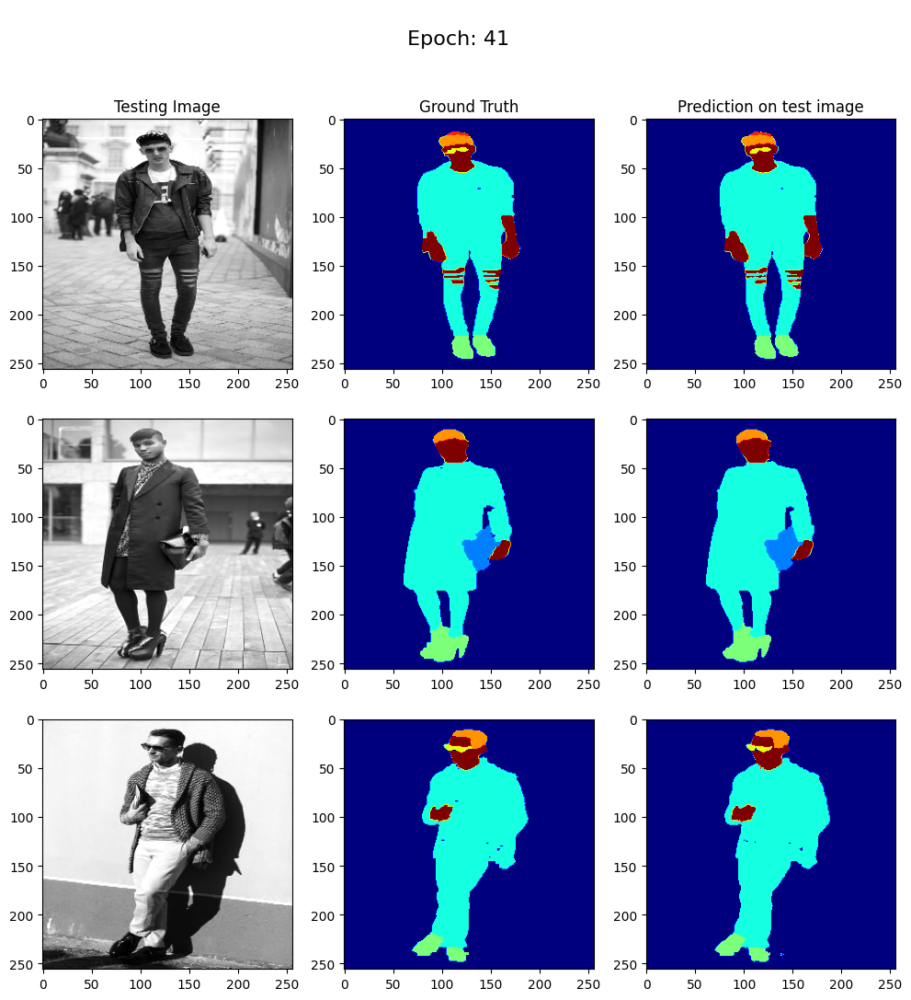

42
57/57 [==============================] - 11s 186ms/step - loss: 0.0077 - accuracy: 0.9970 - val_loss: 0.2819 - val_accuracy: 0.9560
Epoch 43/50
1/1 [==============================] - 0s 38ms/step


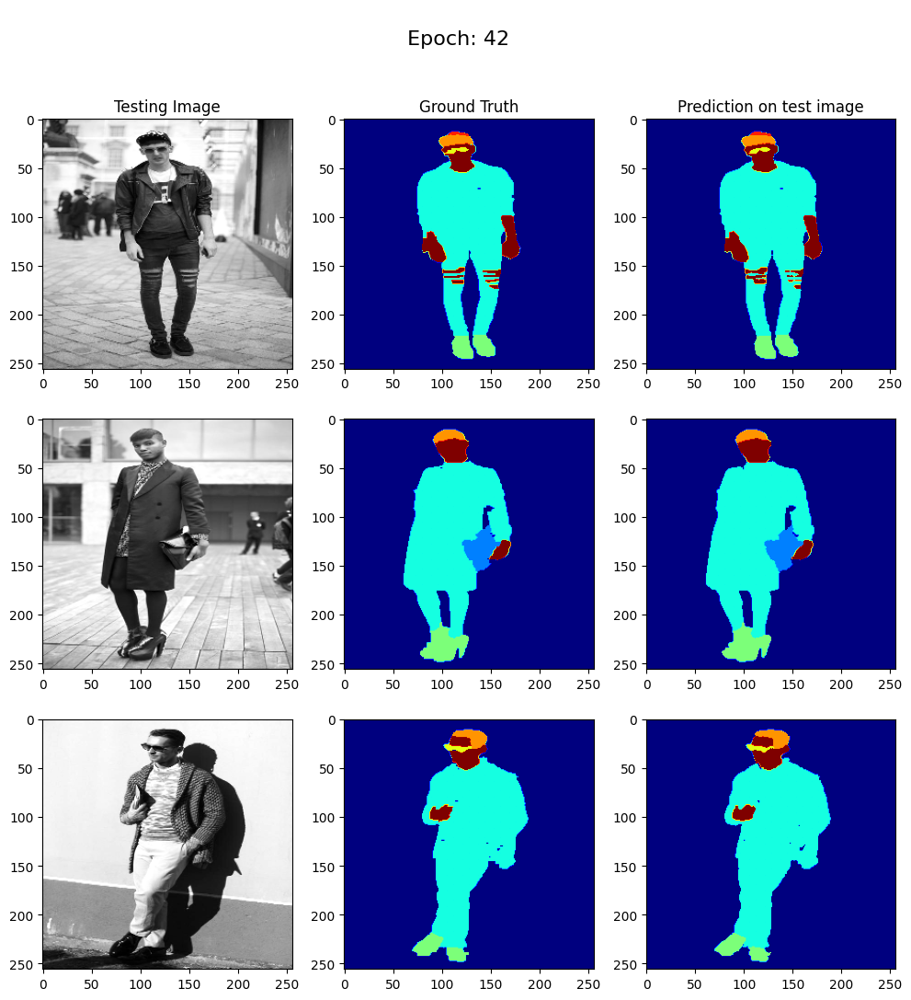

43
57/57 [==============================] - 11s 194ms/step - loss: 0.0075 - accuracy: 0.9971 - val_loss: 0.2816 - val_accuracy: 0.9553
Epoch 44/50
1/1 [==============================] - 0s 38ms/step


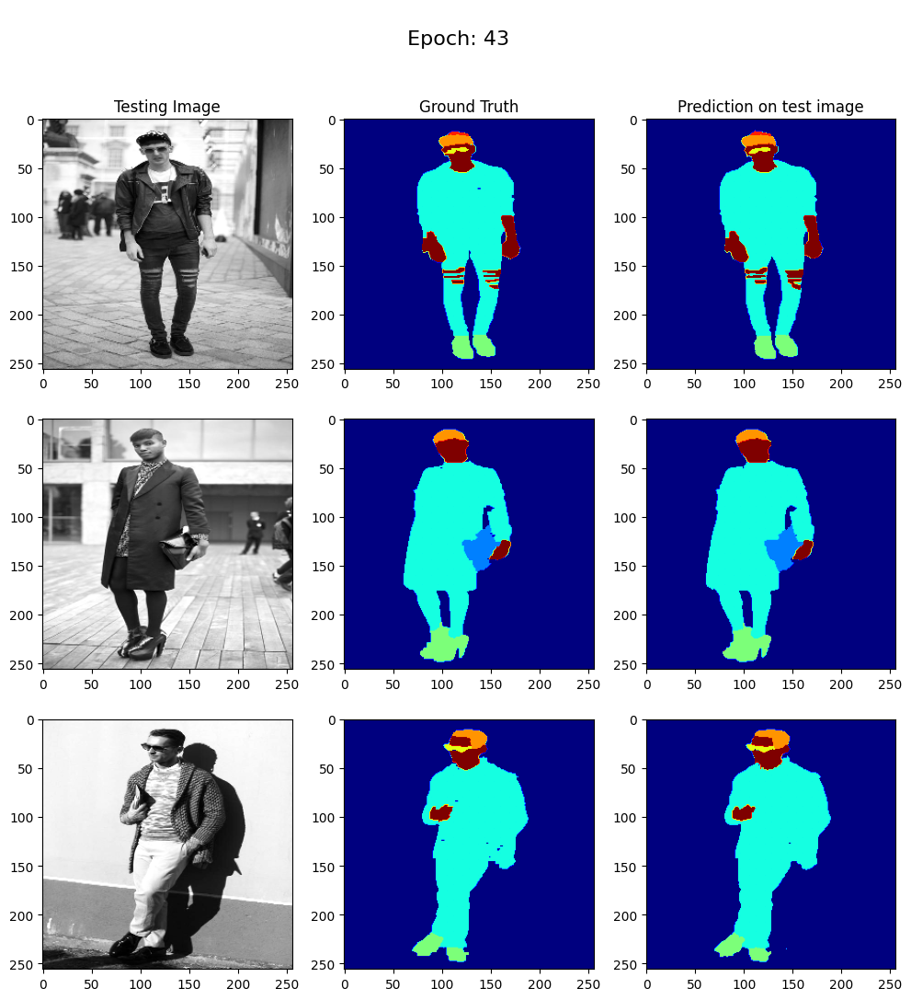

44
57/57 [==============================] - 11s 186ms/step - loss: 0.0079 - accuracy: 0.9969 - val_loss: 0.2949 - val_accuracy: 0.9559
Epoch 45/50
1/1 [==============================] - 0s 41ms/step


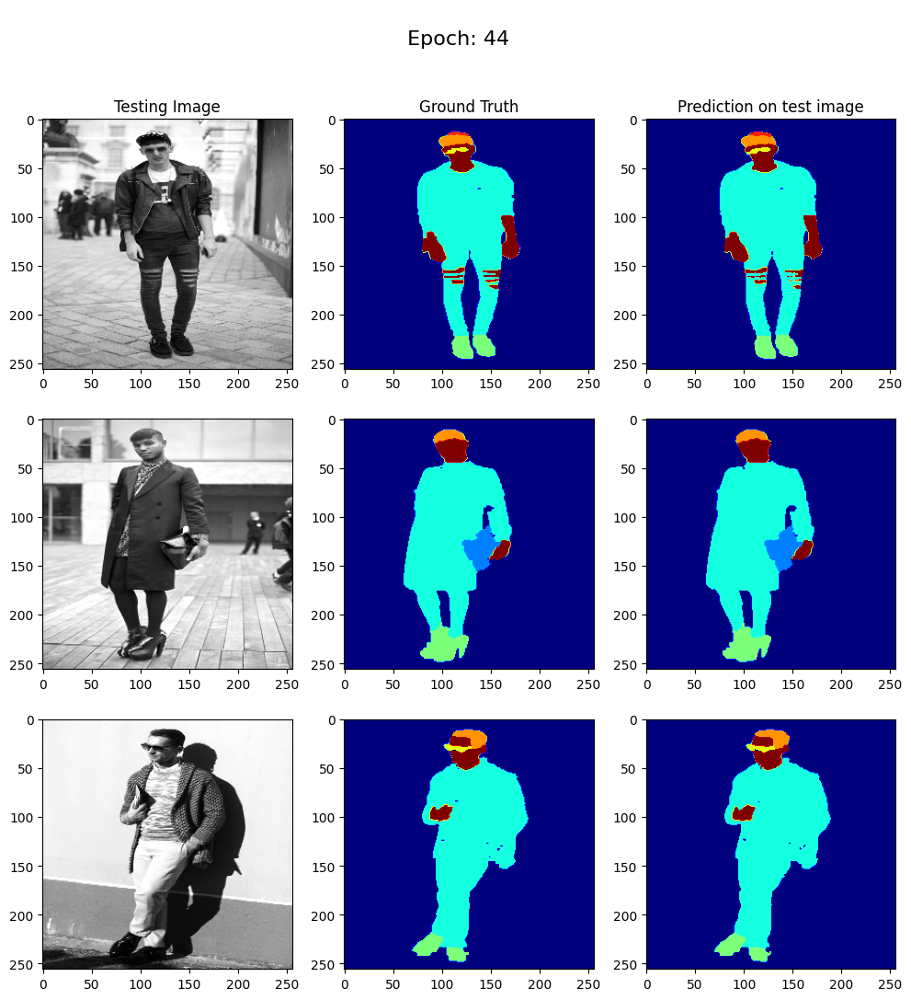

45
57/57 [==============================] - 11s 196ms/step - loss: 0.0078 - accuracy: 0.9970 - val_loss: 0.2868 - val_accuracy: 0.9556
Epoch 46/50
1/1 [==============================] - 0s 65ms/step


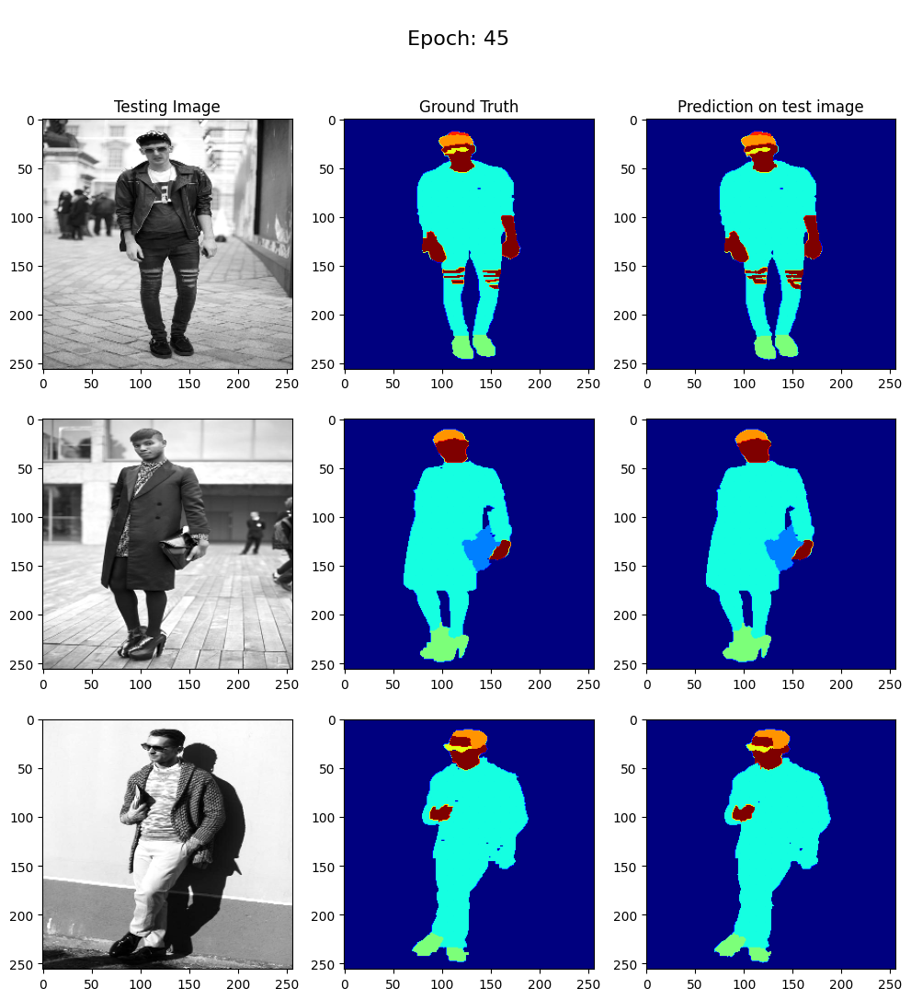

46
57/57 [==============================] - 11s 196ms/step - loss: 0.0079 - accuracy: 0.9969 - val_loss: 0.2965 - val_accuracy: 0.9560
Epoch 47/50
1/1 [==============================] - 0s 42ms/step


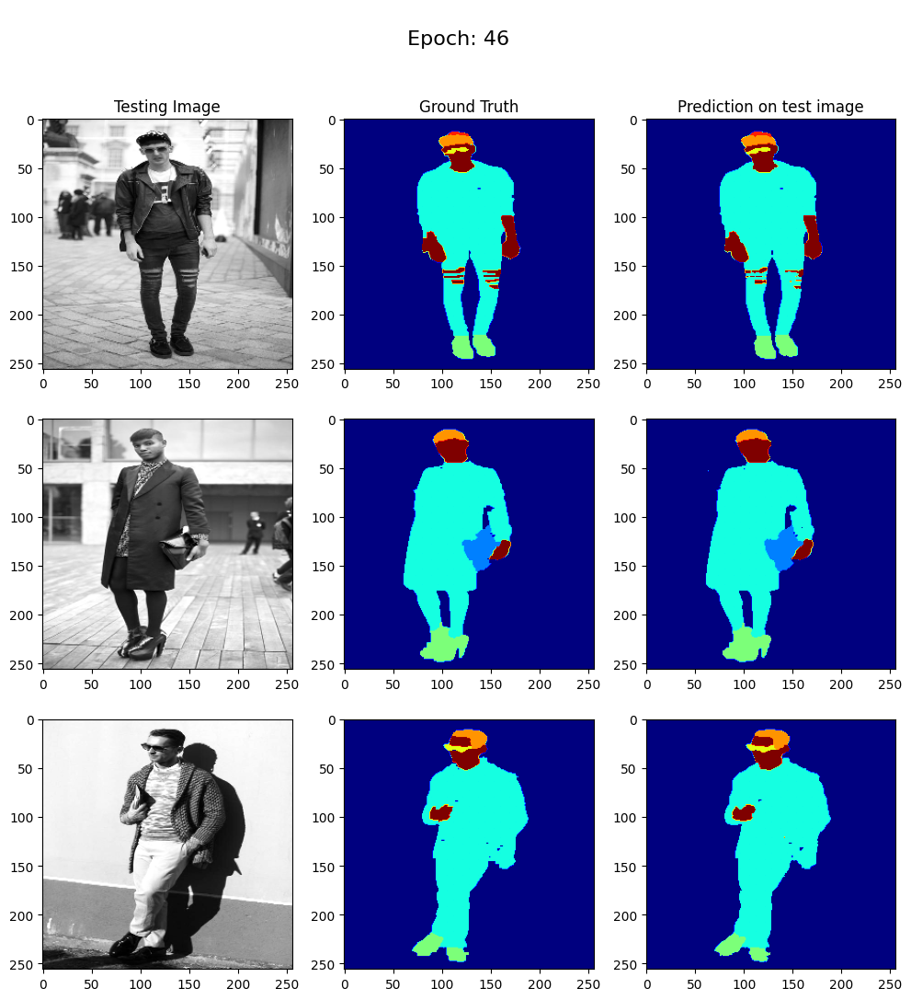

47
57/57 [==============================] - 11s 189ms/step - loss: 0.0076 - accuracy: 0.9970 - val_loss: 0.2910 - val_accuracy: 0.9558
Epoch 48/50
1/1 [==============================] - 0s 39ms/step


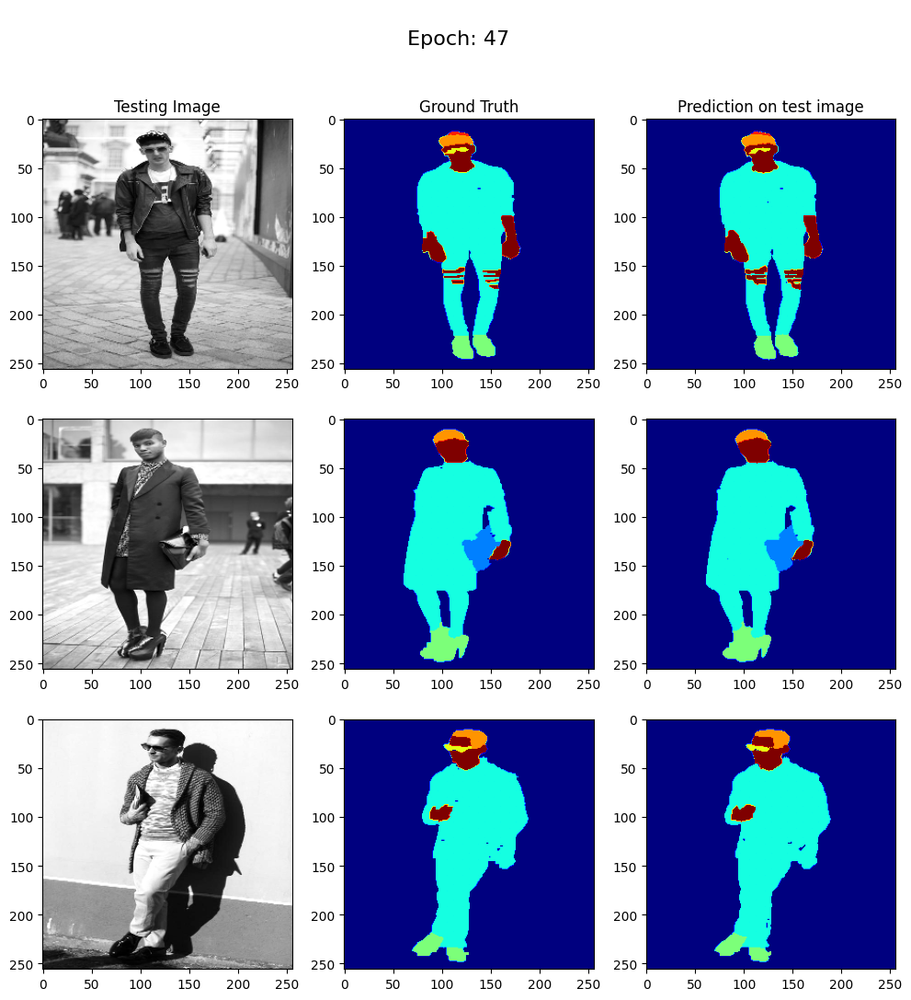

48
57/57 [==============================] - 11s 188ms/step - loss: 0.0076 - accuracy: 0.9971 - val_loss: 0.2887 - val_accuracy: 0.9546
Epoch 49/50
1/1 [==============================] - 0s 52ms/step


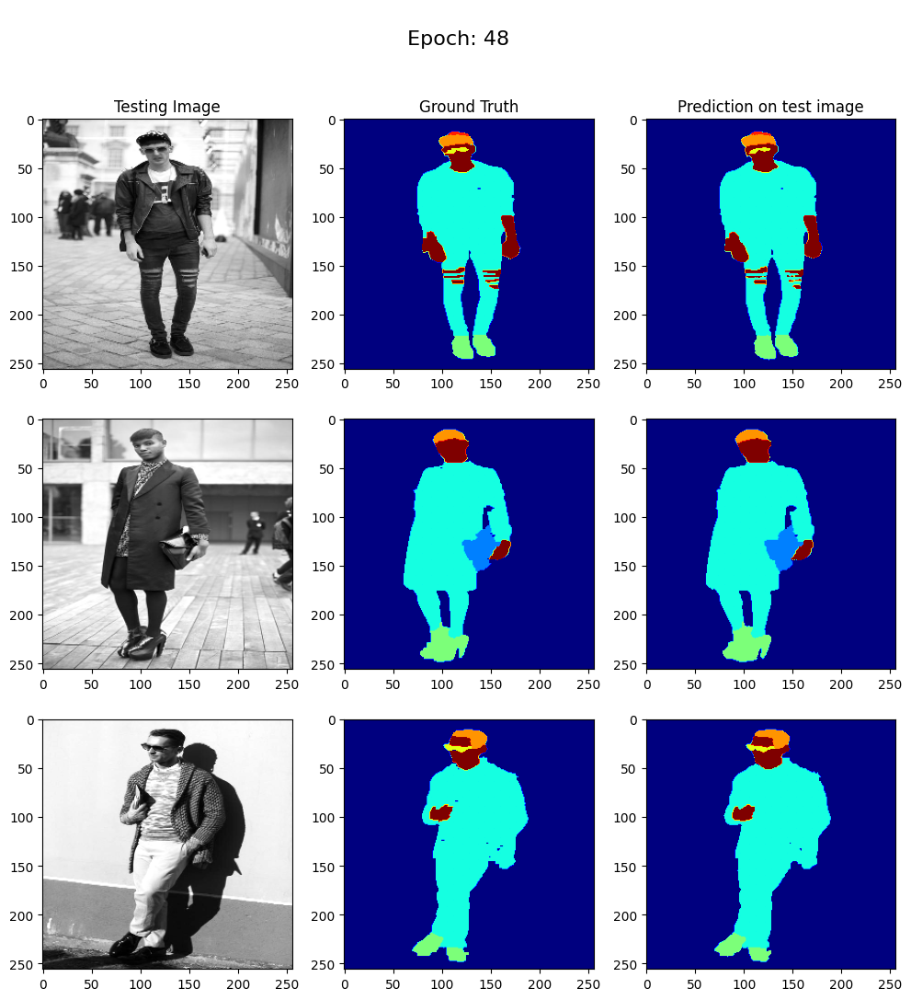

49
57/57 [==============================] - 11s 190ms/step - loss: 0.0082 - accuracy: 0.9968 - val_loss: 0.2902 - val_accuracy: 0.9563
Epoch 50/50
1/1 [==============================] - 0s 37ms/step


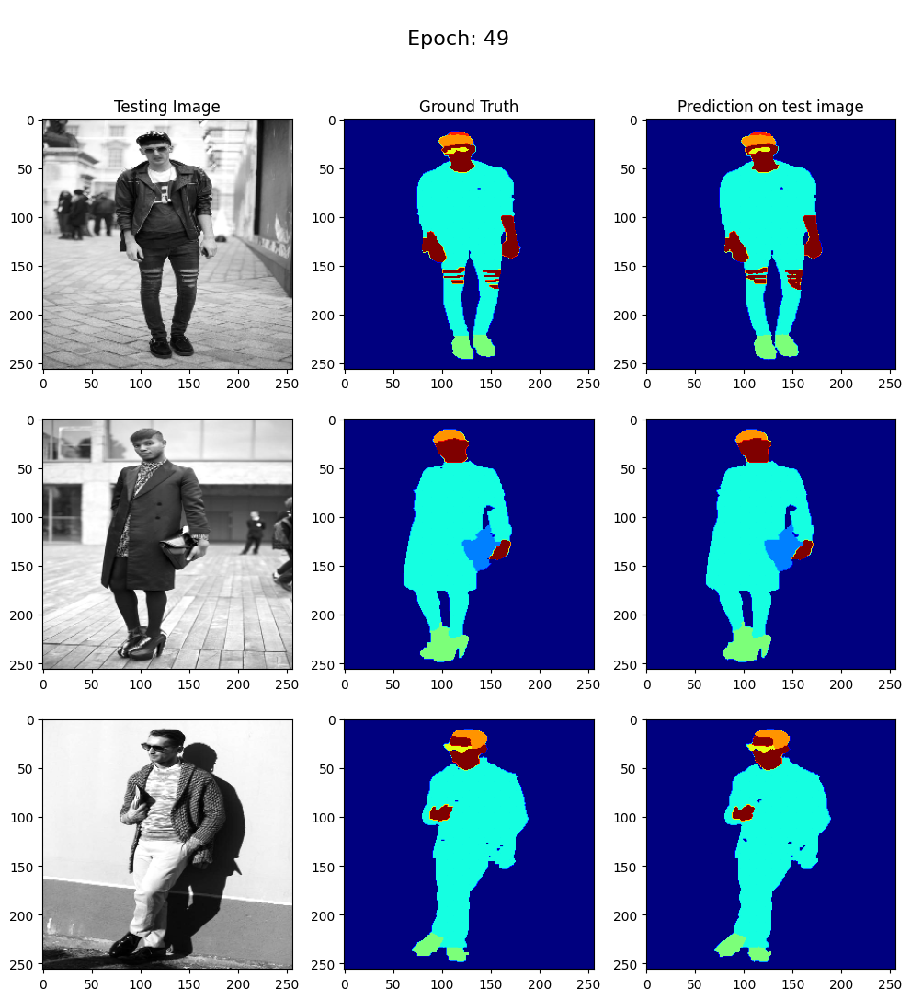

50
57/57 [==============================] - 11s 193ms/step - loss: 0.0082 - accuracy: 0.9968 - val_loss: 0.2923 - val_accuracy: 0.9555


In [28]:
epoch = 50
val_subsplits = 5
batch_size = 16
validation_steps = len(x_val)//batch_size//val_subsplits
steps_per_epoch = len(x_train)//batch_size
# sample_image = train_images[0]
# sample_mask = train_masks[0]

class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        show_predictions(epoch)
        print (format(epoch+1))

model_history = model.fit(x_train, y_train, epochs=epoch,
                           batch_size = batch_size,
                          verbose=1,
                          #steps_per_epoch=STEPS_PER_EPOCH,
                          #validation_steps=VALIDATION_STEPS,
                          validation_data=(x_val, y_val),
                          callbacks=[DisplayCallback()]
                          )

In [33]:
model.save('/models/clothes_50')

In [30]:
# model = load_model('/models/clothes_50')

In [40]:
test_path = '/content/drive/MyDrive/test1'

test_paths = []

for imgname in os.listdir(test_path):
  test_paths.append(os.path.join(test_path,imgname))

1/1 [==============================] - 0s 153ms/step


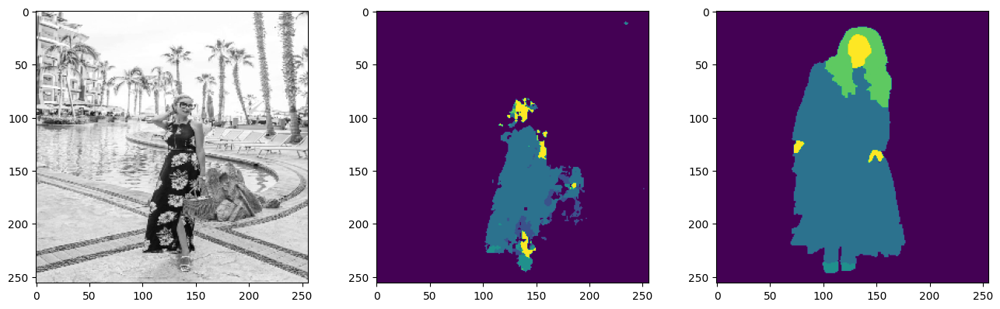

In [48]:
test_path = "/content/drive/MyDrive/test1"
timgnum = 4
img_num = int(test_paths[timgnum].split("/")[-1].split(".")[0].split("_")[-1])
plt.figure(figsize=(16,10))

plt.subplot(2,3,1)
img = cv2.imread(test_paths[timgnum])
img = cv2.resize(img, (size_y, size_x))
img = preprocessing(img)
plt.imshow(img)

plt.subplot(2,3,2)
pred = np.array(create_mask(model.predict(img[tf.newaxis, ...])))
plt.imshow(np.squeeze(pred))

plt.subplot(2,3,3)
plt.imshow(train_masks[img_num-1])

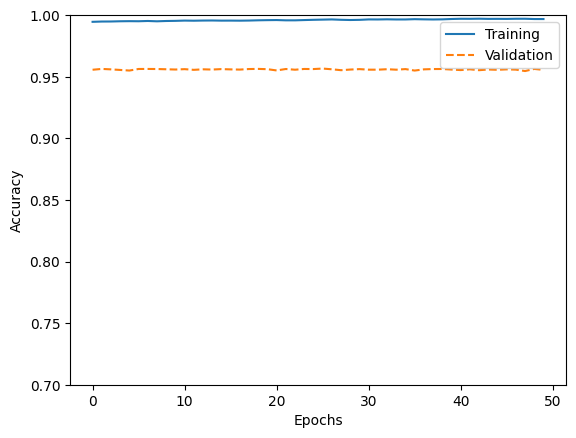

In [49]:
history_1 = model_history.history
acc=history_1['accuracy']
val_acc = history_1['val_accuracy']



plt.plot(acc[:150], '-', label='Training')
plt.plot(val_acc[:150], '--', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.ylim([0.7,1.0])
plt.legend()
plt.show()